In [158]:
#imports
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader, TensorDataset, Subset, ConcatDataset
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
from sklearn.model_selection import KFold
from transformers import AutoImageProcessor, AutoModelForImageClassification
import cv2 
import time
import torchvision.models as models
import copy
import warnings

# Suppress specific warnings
warnings.filterwarnings("ignore", message="To copy construct from a tensor*")



# 1. Data Exploration and Preprocessing

In [86]:
#dataset
df = pd.read_csv('fer2013.csv')
print(df.shape)

(35887, 3)


In [87]:
df

,emotion,pixels,Usage
0,0,70 80 82 72 58 58 60 63 54 58 60 48 89 115 121...,Training
1,0,151 150 147 155 148 133 111 140 170 174 182 15...,Training
2,2,231 212 156 164 174 138 161 173 182 200 106 38...,Training
3,4,24 32 36 30 32 23 19 20 30 41 21 22 32 34 21 1...,Training
4,6,4 0 0 0 0 0 0 0 0 0 0 0 3 15 23 28 48 50 58 84...,Training
...,...,...,...
35882,6,50 36 17 22 23 29 33 39 34 37 37 37 39 43 48 5...,PrivateTest
35883,3,178 174 172 173 181 188 191 194 196 199 200 20...,PrivateTest
35884,0,17 17 16 23 28 22 19 17 25 26 20 24 31 19 27 9...,PrivateTest
35885,3,30 28 28 29 31 30 42 68 79 81 77 67 67 71 63 6...,PrivateTest


In [88]:
df.isnull().sum()

emotion    0
pixels     0
Usage      0
dtype: int64

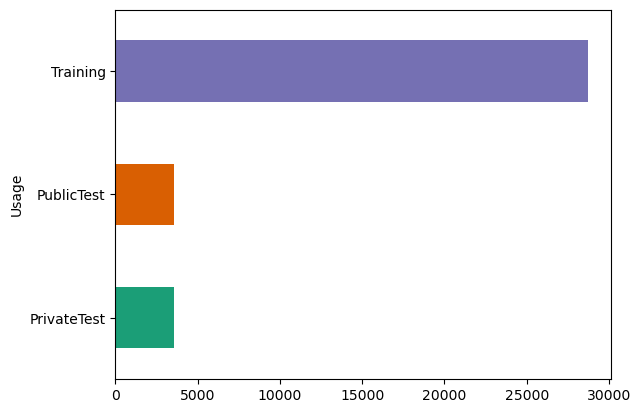

In [89]:
df.groupby('Usage').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.show()

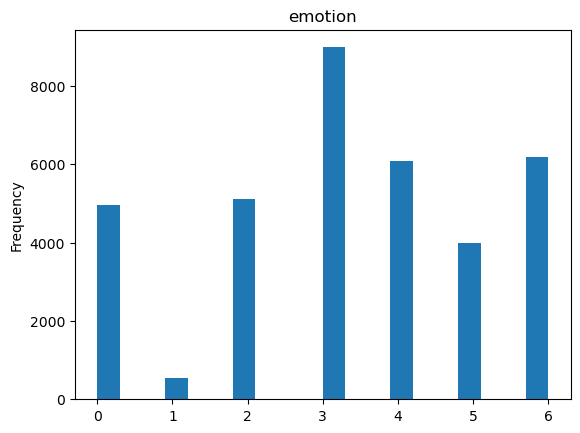

In [90]:
df['emotion'].plot(kind='hist', bins=20, title='emotion')
plt.show()

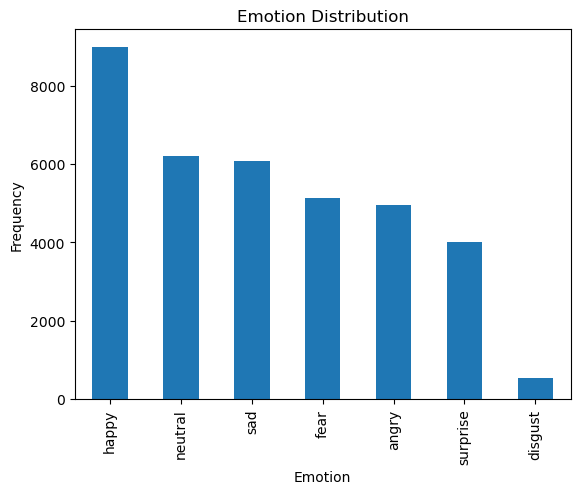

In [91]:
# Dictionary mapping emotion labels to text
emotion_label = {0: 'angry', 1: 'disgust', 2: 'fear', 3: 'happy', 4: 'sad', 5: 'surprise', 6: 'neutral'}


# Map numerical labels to emotion names
df['emotionLabels'] = df['emotion'].map(emotion_label)

# Plot the histogram of emotion labels
df['emotionLabels'].value_counts().plot(kind='bar', title='Emotion Distribution')
plt.xlabel('Emotion')
plt.ylabel('Frequency')
plt.show()

In [92]:
#unique emotions
df['emotionLabels'].unique()

array(['angry', 'fear', 'sad', 'neutral', 'happy', 'surprise', 'disgust'],
      dtype=object)

/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_2314/2646508811.py:16: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


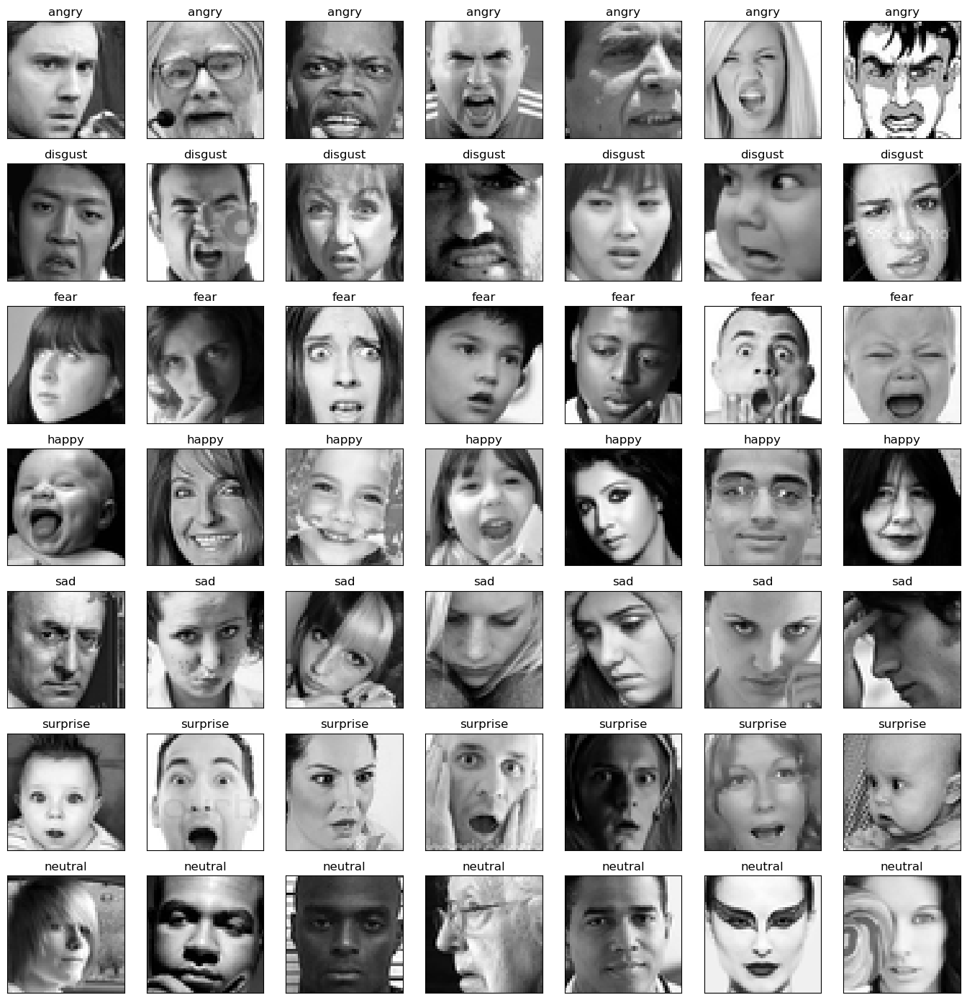

In [93]:
#plot images
fig = plt.figure(1, (14, 14))

k = 0
for label in sorted(df.emotion.unique()):
    for j in range(7):
        px = df[df.emotion==label].pixels.iloc[k]
        # reshaped to a 48x48 matrix and cast to float32.
        px = np.array(px.split(' ')).reshape(48, 48).astype('float32')

        k += 1
        ax = plt.subplot(7, 7, k)
        ax.imshow(px, cmap='gray')
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(emotion_label [label])
        plt.tight_layout()

In [94]:
#load dataset
class FERDataset(Dataset):
    def __init__(self, csv_file, transform=None, usage='Training'):
        self.data = pd.read_csv(csv_file)
        self.transform = transform
        self.data = self.data[self.data['Usage'] == usage]

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        pixels = self.data.iloc[idx, 1]
        emotion = int(self.data.iloc[idx, 0])
        # Reshape pixel values and convert to numpy array
        image = np.array(list(map(int, pixels.split())), dtype=np.uint8).reshape(48, 48)
        image = Image.fromarray(image)
        if self.transform:
            image = self.transform(image)
        return image, emotion
    


In [160]:
class FERDataset(Dataset):
    def __init__(self, csv_file, transform=None, usage='Training'):
        self.data = pd.read_csv(csv_file)
        self.transform = transform
        self.data = self.data[self.data['Usage'] == usage]

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        pixels = self.data.iloc[idx, 1]
        emotion = int(self.data.iloc[idx, 0])
        # Reshape pixel values and convert to numpy array
        image = np.array(list(map(int, pixels.split())), dtype=np.uint8).reshape(48, 48)
        # Convert grayscale image to RGB
        image = Image.fromarray(image).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, emotion


In [161]:
# Define transformations for data augmentation and normalization
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor()
])

# Define transformations for data augmentation and normalization
transform_1 = transforms.Compose([
    transforms.ToTensor()
])

In [162]:
# Initialize datasets and apply transformations
train_dataset = FERDataset('fer2013.csv', transform=transform, usage='Training')
val_dataset = FERDataset('fer2013.csv', transform=transform_1, usage='PublicTest')
test_dataset = FERDataset('fer2013.csv', transform=transform_1, usage='PrivateTest')

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=200, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=200, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=200, shuffle=False)

In [163]:
train_loader

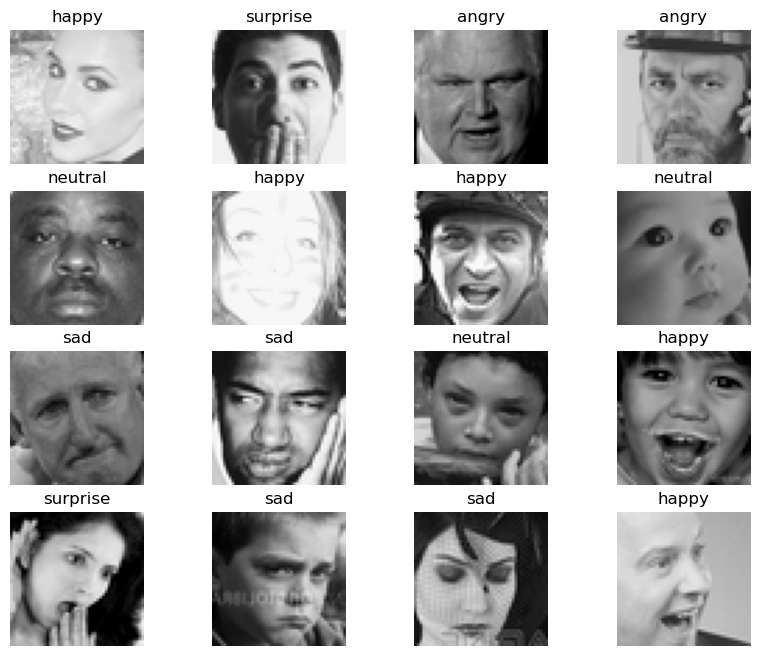

In [164]:
# Function to plot images
def plot_images(images, labels, label_mapping=None, nrows=4, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(10, 8))
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].permute(1, 2, 0), cmap='gray') 
        if label_mapping:
            ax.set_title(label_mapping[labels[i].item()]) 
        else:
            ax.set_title(f'Label: {labels[i]}')
        ax.axis('off')

#plot a batch of images from the train_loader
images, labels = next(iter(train_loader))
plot_images(images, labels, label_mapping=emotion_label)

plt.show()


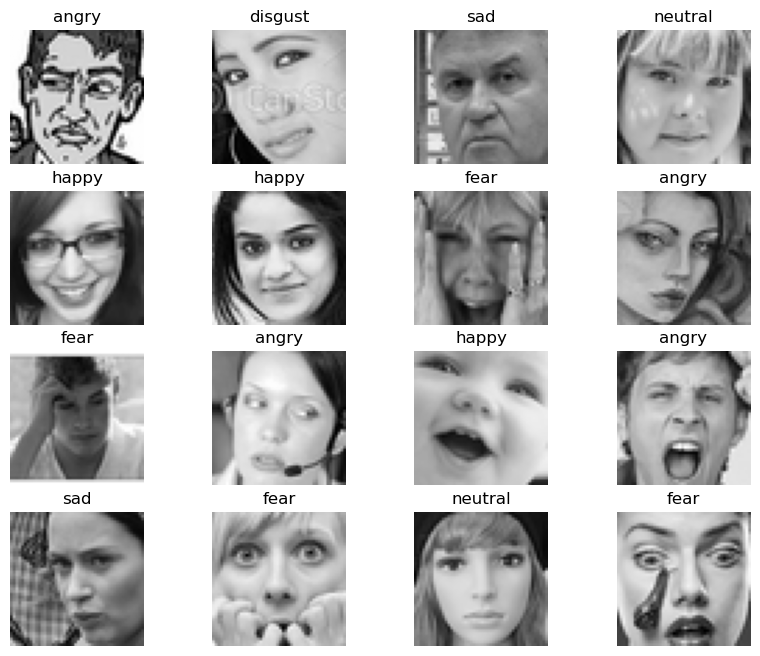

In [165]:
# Function to plot images
def plot_images(images, labels, label_mapping=None, nrows=4, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(10, 8))
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i].permute(1, 2, 0), cmap='gray')  # Assuming images are tensors
        if label_mapping:
            ax.set_title(label_mapping[labels[i].item()])  # Convert tensor label to integer
        else:
            ax.set_title(f'Label: {labels[i]}')
        ax.axis('off')

#plot a batch of images from the train_loader
images, labels = next(iter(val_loader))
plot_images(images, labels, label_mapping=emotion_label)

plt.show()


# RESNET model

Started with a pretraind model

In [166]:
# Define the ResNet model
class ResNetModel(nn.Module):
    def __init__(self, num_classes):
        super(ResNetModel, self).__init__()
        self.resnet = models.resnet18(pretrained=True)
        in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(in_features, num_classes)
        
    def forward(self, x):
        return self.resnet(x)

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define the model
num_classes = 7 
model = ResNetModel(num_classes).to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training the model
def train(model, train_loader, criterion, optimizer, num_epochs=10):
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * inputs.size(0)
        
        epoch_loss = running_loss / len(train_loader.dataset)
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}")

# Validate the model
def validate(model, val_loader, criterion):
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)
    
    val_loss = running_loss / len(val_loader.dataset)
    val_acc = correct / total
    print(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_acc:.4f}")

# Test the model
def test(model, test_loader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)
    
    test_acc = correct / total
    print(f"Test Accuracy: {test_acc:.4f}")

# Train the model
num_epochs = 15
train(model, train_loader, criterion, optimizer, num_epochs)

# Validate the model
validate(model, val_loader, criterion)

# Test the model
test(model, test_loader)


/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/15, Loss: 1.3555
Epoch 2/15, Loss: 1.1053
Epoch 3/15, Loss: 1.0229
Epoch 4/15, Loss: 0.9483
Epoch 5/15, Loss: 0.8871
Epoch 6/15, Loss: 0.8242
Epoch 7/15, Loss: 0.7672
Epoch 8/15, Loss: 0.7105
Epoch 9/15, Loss: 0.6499
Epoch 10/15, Loss: 0.6025
Epoch 11/15, Loss: 0.5410
Epoch 12/15, Loss: 0.4907
Epoch 13/15, Loss: 0.4384
Epoch 14/15, Loss: 0.3878
Epoch 15/15, Loss: 0.3474
Validation Loss: 1.4261, Validation Accuracy: 0.6130
Test Accuracy: 0.6216


# 2. Build Custom CNN Model Function

In [230]:
# Define the CNN model
class CNNModel(nn.Module):
    def __init__(self, activation_function='relu', padding='same', kernel_sizes=[(3,3)], filters=(8, 12), 
                 pooling_kernels = [(2,2)], dilation_rate = (1,1), strides = (1,1), 
                 input_shape=(1, 48, 48), dense_units=[], output_classes=7, dropout_rate=0):
        super(CNNModel, self).__init__()

        # Initialize parameters
        self.activation_function = activation_function
        self.conv_layers = nn.ModuleList()
        self.pooling_layers = nn.ModuleList()
        self.batchnorm_layers = nn.ModuleList()
        self.dropout_rate = dropout_rate

        in_channels = input_shape[0]
        for i in range(len(filters)):
            # Add convolutional layers
            self.conv_layers.append(nn.Conv2d(
                in_channels=in_channels,
                out_channels=filters[i],
                kernel_size=kernel_sizes[i],
                padding='same' if padding == 'same' else 0,
                stride=strides,
                dilation=dilation_rate if i == 0 else (1, 1)
            ))
            in_channels = filters[i]
            
            # Add pooling layers if specified
            if i < len(pooling_kernels):
                self.pooling_layers.append(nn.MaxPool2d(kernel_size=pooling_kernels[i]))

            # Add batch normalization layers if dropout rate is not zero
            if dropout_rate != 0:
                self.batchnorm_layers.append(nn.BatchNorm2d(filters[i]))
        
        # Add flattening layer
        self.flatten = nn.Flatten()

        # Calculate the size of the output from the last convolutional layer
        self.conv_output_size = self._get_conv_output_size(input_shape)
        
        self.fc_layers = nn.ModuleList()
        in_features = self.conv_output_size
        for units in dense_units:
            # Add fully connected layers
            self.fc_layers.append(nn.Linear(in_features, units))
            in_features = units
        
        # Add the output layer
        self.output_layer = nn.Linear(in_features, output_classes)

    def _get_conv_output_size(self, input_shape):
        # Helper function to calculate the output size of the convolutional layers
        with torch.no_grad():
            input_tensor = torch.zeros(1, *input_shape)
            output = input_tensor
            for i in range(len(self.conv_layers)):
                output = self.conv_layers[i](output)
                if i < len(self.pooling_layers):
                    output = self.pooling_layers[i](output)
                if self.dropout_rate != 0:
                    output = self.batchnorm_layers[i](output)
            output_size = output.numel()
        return output_size

    def forward(self, x):
        # Forward pass through the convolutional layers
        for i in range(len(self.conv_layers)):
            x = self.conv_layers[i](x)
            if self.activation_function == 'relu':
                x = F.relu(x)
            elif self.activation_function == 'sigmoid':
                x = torch.sigmoid(x)
            elif self.activation_function == 'tanh':
                x = torch.tanh(x)
            
            if i < len(self.pooling_layers):
                x = self.pooling_layers[i](x)

            if self.dropout_rate != 0:
                x = self.batchnorm_layers[i](x)
                x = F.dropout(x, p=self.dropout_rate, training=self.training)
        
        # Flatten the output
        x = self.flatten(x)
        
        # Forward pass through the fully connected layers
        for layer in self.fc_layers:
            x = layer(x)
            if self.activation_function == 'relu':
                x = F.relu(x)
            elif self.activation_function == 'sigmoid':
                x = torch.sigmoid(x)
            elif self.activation_function == 'tanh':
                x = torch.tanh(x)
            if self.dropout_rate != 0:
                x = F.dropout(x, p=self.dropout_rate, training=self.training)

        # Forward pass through the output layer
        x = self.output_layer(x)
        
        # Apply softmax activation to the output
        return F.softmax(x, dim=1)


In [231]:
# Extract Images
def extract_images(datapoints):
    width, height = 48, 48
    X = []
    for sequence in datapoints:
        pixels = [int(p) for p in sequence.split(' ')]
        pixels = np.asarray(pixels).reshape(width, height)
        X.append(pixels.astype('float32'))
    X = np.asarray(X)
    X = np.expand_dims(X, 1) 
    return X

# Load and preprocess FER13 data
def load_FER13():
    data = pd.read_csv('fer2013.csv')
    X = data['pixels']
    Y = data['emotion']
    
    x_train = X[data['Usage'] == 'Training'].values
    x_val = X[data['Usage'] == 'PrivateTest'].values
    x_test = X[data['Usage'] == 'PublicTest'].values

    y_train = Y[data['Usage'] == 'Training'].values
    y_val = Y[data['Usage'] == 'PrivateTest'].values
    y_test = Y[data['Usage'] == 'PublicTest'].values

    onehot_encoder = OneHotEncoder(sparse=False)
    y_train = onehot_encoder.fit_transform(y_train.reshape(-1, 1))
    y_val = onehot_encoder.transform(y_val.reshape(-1, 1))
    y_test = onehot_encoder.transform(y_test.reshape(-1, 1))

    x_train = extract_images(x_train)
    x_val = extract_images(x_val)
    x_test = extract_images(x_test)

    train_mean = np.mean(x_train, axis=0)
    train_std = np.std(x_train, axis=0)

    x_train = (x_train - train_mean) / train_std
    x_val = (x_val - train_mean) / train_std
    x_test = (x_test - train_mean) / train_std

    x_train = torch.tensor(x_train, dtype=torch.float32)
    x_val = torch.tensor(x_val, dtype=torch.float32)
    x_test = torch.tensor(x_test, dtype=torch.float32)
    y_train = torch.tensor(y_train, dtype=torch.long)
    y_val = torch.tensor(y_val, dtype=torch.long)
    y_test = torch.tensor(y_test, dtype=torch.long)

    return (x_train, y_train), (x_val, y_val), (x_test, y_test)

# Compile model
def compile_model(model, initial_lr, lr_decay):
    optimizer = optim.Adam(model.parameters(), lr=initial_lr)
    if lr_decay != 1:
        scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=lr_decay)
    else:
        scheduler = None
    criterion = nn.CrossEntropyLoss()
    return model, optimizer, criterion, scheduler

In [232]:
# Training and evaluation function
def run_test(model, optimizer, criterion, scheduler, epochs, batch_size, model_name=''):
    train_data = TensorDataset(torch.tensor(x_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
    val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
    test_data = TensorDataset(torch.tensor(x_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32))

    train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_data, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=False)

    history = {'loss': [], 'val_loss': [], 'accuracy': [], 'val_accuracy': []}
    start_time = time.time()

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            
            # Convert one-hot encoded labels to class indices
            labels = torch.argmax(labels, dim=1)
            
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_loader)
        epoch_acc = 100 * correct / total
        history['loss'].append(epoch_loss)
        history['accuracy'].append(epoch_acc)

        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0
        with torch.no_grad():
            for val_inputs, val_labels in val_loader:
                val_outputs = model(val_inputs)
                
                # Convert one-hot encoded labels to class indices
                val_labels = torch.argmax(val_labels, dim=1)
                
                val_loss += criterion(val_outputs, val_labels).item()
                _, val_predicted = torch.max(val_outputs.data, 1)
                val_total += val_labels.size(0)
                val_correct += (val_predicted == val_labels).sum().item()

        val_loss /= len(val_loader)
        val_acc = 100 * val_correct / val_total
        history['val_loss'].append(val_loss)
        history['val_accuracy'].append(val_acc)

        if scheduler:
            scheduler.step()

        print(f"Epoch {epoch+1}/{epochs}, Loss: {epoch_loss:.4f}, Accuracy: {epoch_acc:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_acc:.2f}%")

    # Evaluate on test data
    test_loss = 0.0
    test_correct = 0
    test_total = 0
    model.eval()
    with torch.no_grad():
        for test_inputs, test_labels in test_loader:
            test_outputs = model(test_inputs)
            
            # Convert one-hot encoded labels to class indices
            test_labels = torch.argmax(test_labels, dim=1)
            
            test_loss += criterion(test_outputs, test_labels).item()
            _, test_predicted = torch.max(test_outputs.data, 1)
            test_total += test_labels.size(0)
            test_correct += (test_predicted == test_labels).sum().item()

    test_loss /= len(test_loader)
    test_acc = 100 * test_correct / test_total

    print("Evaluate on test data")
    print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_acc:.2f}%")
    print("--- %s seconds ---" % (time.time() - start_time))

    torch.save(model.state_dict(), model_name + '.pth')
    np.save(model_name + '_history.npy', history)
    return history

# 3. Model Hyperparameter Optimization

Experiments with the varous model hyperparameters to find the optimal model setup.

In [109]:
#Load Data
(x_train, y_train), (x_val, y_val), (x_test, y_test) = load_FER13()


/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


# Number of Layers and Units

Experiment with layer sizes of (64, 4), (16, 6)

In [110]:
# Main loop
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20

#Filters and Layers
test_set = [(64, 4), (16, 6)]
histories = []

for initial, layers in test_set:
    kernelsizes = [(3, 3) for _ in range(layers)]
    pooling = [(2, 2) for _ in range(3)]

    filterunits = [initial * (2 ** i) for i in range(len(kernelsizes))]
    dense = [filterunits[-1], filterunits[-2]]

    model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

    model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.25)

    model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay)
    print(model)
    histories.append(run_test(model, optimizer, criterion, scheduler, epochs, batchsize, model_name))

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

Plot loss and accuracy over epoch

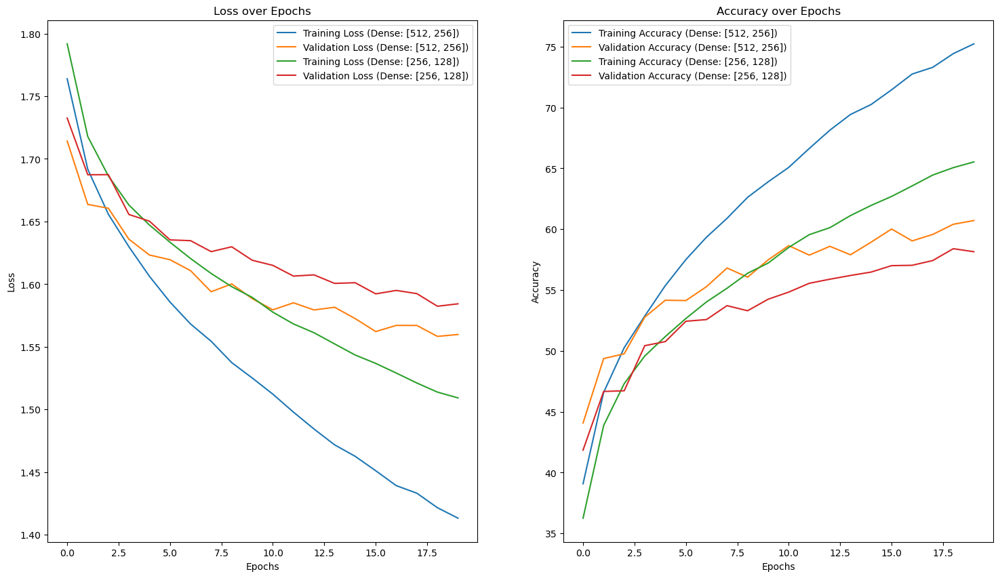

In [111]:
# Define the fixed kernel size and dense layer configurations
kernel_size = (3, 3)
dense_configs = [[512, 256], [256, 128]]
filters_layers [(64, 4), (16, 6)]

# Initialize the plots
plt.figure(figsize=(18, 10))

# Create subplots for loss and accuracy
ax1 = plt.subplot(1, 2, 1)
ax2 = plt.subplot(1, 2, 2)

# Iterate over each dense configuration
for dense in dense_configs:
    # Construct the filename
    filename = f'lr=0.0001 bsize=64 l2=0 kernels={[kernel_size]*4} dense={dense}_history.npy'
    
    # Load the training history
    history = np.load(filename, allow_pickle=True).item()

    # Extract loss and accuracy
    loss = history['loss']
    val_loss = history['val_loss']
    accuracy = history['accuracy']
    val_accuracy = history['val_accuracy']

    # Plot the loss over epochs
    ax1.plot(loss, label=f'Training Loss (Dense: {dense})')
    ax1.plot(val_loss, label=f'Validation Loss (Dense: {dense})')

    # Plot the accuracy over epochs
    ax2.plot(accuracy, label=f'Training Accuracy (Dense: {dense})')
    ax2.plot(val_accuracy, label=f'Validation Accuracy (Dense: {dense})')

# Set titles and labels for the loss subplot
ax1.set_title('Loss over Epochs')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.legend()

# Set titles and labels for the accuracy subplot
ax2.set_title('Accuracy over Epochs')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.legend()

# Show the plots
plt.show()


# Kernel Size

Experiment with kernel sizes of (3,3), (5,5), (7,7)

In [38]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4


# kernel sizes
test_set = [(3,3), (5,5), (7,7)]
histories = []
for k_size in test_set:
    kernelsizes = [k_size for _ in range(layers)]
    pooling = [(2, 2) for _ in range(3)]

    filterunits = [initial * (2 ** i) for i in range(len(kernelsizes))]
    dense = [filterunits[-1], filterunits[-2]]

    model_name = f'lr={learning_rate} bsize={batchsize} l2={L2_reg_rate} kernels={kernelsizes} dense={dense}'

    model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.25)

    model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay)
    print(model)
    histories.append(run_test(model, optimizer, criterion, scheduler, epochs, batchsize, model_name))

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:165: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  train_data = TensorDataset(torch.tensor(x_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:166: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:167: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().

Epoch 1/20, Loss: 1.7649, Accuracy: 38.73%, Val Loss: 1.7216, Val Accuracy: 43.08%
Epoch 2/20, Loss: 1.6913, Accuracy: 46.56%, Val Loss: 1.6786, Val Accuracy: 47.98%
Epoch 3/20, Loss: 1.6573, Accuracy: 50.09%, Val Loss: 1.6649, Val Accuracy: 49.46%
Epoch 4/20, Loss: 1.6259, Accuracy: 53.46%, Val Loss: 1.6495, Val Accuracy: 50.93%
Epoch 5/20, Loss: 1.6072, Accuracy: 55.29%, Val Loss: 1.6258, Val Accuracy: 53.50%
Epoch 6/20, Loss: 1.5896, Accuracy: 57.26%, Val Loss: 1.6190, Val Accuracy: 54.17%
Epoch 7/20, Loss: 1.5713, Accuracy: 58.99%, Val Loss: 1.6043, Val Accuracy: 55.50%
Epoch 8/20, Loss: 1.5545, Accuracy: 60.91%, Val Loss: 1.6001, Val Accuracy: 55.75%
Epoch 9/20, Loss: 1.5404, Accuracy: 62.33%, Val Loss: 1.5942, Val Accuracy: 56.51%
Epoch 10/20, Loss: 1.5274, Accuracy: 63.57%, Val Loss: 1.5891, Val Accuracy: 57.15%
Epoch 11/20, Loss: 1.5136, Accuracy: 65.05%, Val Loss: 1.5923, Val Accuracy: 57.15%
Epoch 12/20, Loss: 1.4997, Accuracy: 66.46%, Val Loss: 1.5811, Val Accuracy: 57.87%
E

Plot loss and accuracy over epoch

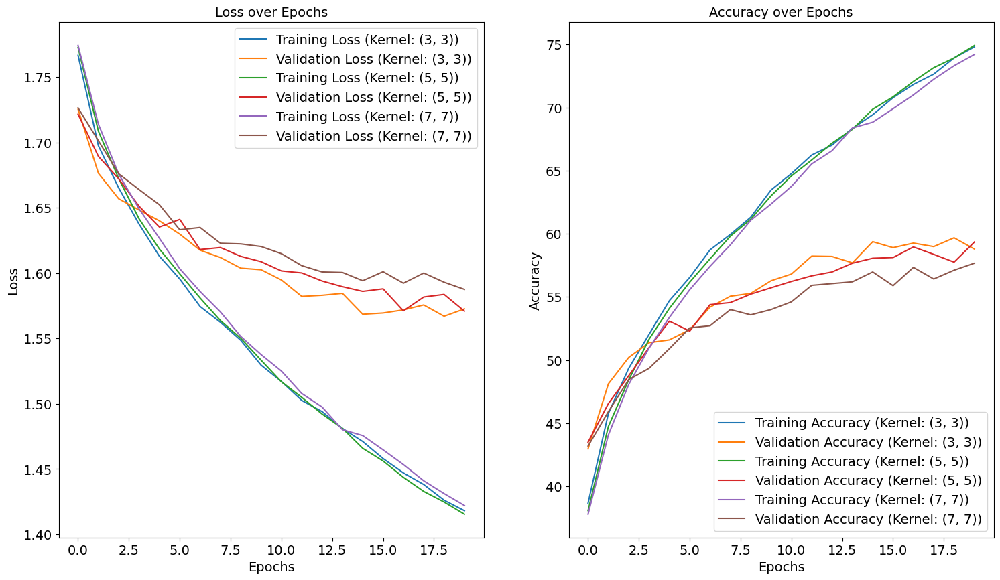

In [49]:
# Define the kernel sizes
kernel_sizes = [(3, 3), (5, 5), (7, 7)]

# Initialize the plots
plt.figure(figsize=(18, 10))

# Create subplots for loss and accuracy
ax1 = plt.subplot(1, 2, 1)
ax2 = plt.subplot(1, 2, 2)

# Iterate over each kernel size
for kernel in kernel_sizes:
    # Construct the filename
    filename = f'lr=0.0001 bsize=64 l2=0 kernels={[kernel]*4} dense=[512, 256]_history.npy'
    
    # Load the training history
    history = np.load(filename, allow_pickle=True).item()

    # Extract loss and accuracy
    loss = history['loss']
    val_loss = history['val_loss']
    accuracy = history['accuracy']
    val_accuracy = history['val_accuracy']

    # Plot the loss over epochs
    ax1.plot(loss, label=f'Training Loss (Kernel: {kernel})')
    ax1.plot(val_loss, label=f'Validation Loss (Kernel: {kernel})')

    # Plot the accuracy over epochs
    ax2.plot(accuracy, label=f'Training Accuracy (Kernel: {kernel})')
    ax2.plot(val_accuracy, label=f'Validation Accuracy (Kernel: {kernel})')

# Set titles and labels for the loss subplot
ax1.set_title('Loss over Epochs')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.legend()

# Set titles and labels for the accuracy subplot
ax2.set_title('Accuracy over Epochs')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.legend()

# Show the plots
plt.show()


# Dropout Rate

Experiment with dropout rates of 0.2, 0.3, 0.4, 0.5

In [53]:
### HYPERPARAMETERS
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4

# Dropout rates
test_set = [0.2, 0.3, 0.4, 0.5] 
histories = []

for dropout in test_set:
    kernelsizes = [(3,3) for _ in range(layers)]
    pooling = [(2, 2) for _ in range(3)]

    filterunits = [initial * (2 ** i) for i in range(len(kernelsizes))]
    dense = [filterunits[-1], filterunits[-2]]

    model_name = f'kernels={kernelsizes} dropout_rate={dropout}'

    model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=dropout)

    model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay)
    print(model)
    histories.append(run_test(model, optimizer, criterion, scheduler, epochs, batchsize, model_name))

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:165: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  train_data = TensorDataset(torch.tensor(x_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:166: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
/var/folders/_w/d0wdbx015f30z7zvv4k2hcdw0000gn/T/ipykernel_70398/58479478.py:167: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().

Epoch 1/20, Loss: 1.7514, Accuracy: 40.24%, Val Loss: 1.6973, Val Accuracy: 45.72%
Epoch 2/20, Loss: 1.6792, Accuracy: 47.88%, Val Loss: 1.6585, Val Accuracy: 49.85%
Epoch 3/20, Loss: 1.6422, Accuracy: 51.63%, Val Loss: 1.6621, Val Accuracy: 50.38%
Epoch 4/20, Loss: 1.6177, Accuracy: 54.17%, Val Loss: 1.6201, Val Accuracy: 54.33%
Epoch 5/20, Loss: 1.5952, Accuracy: 56.54%, Val Loss: 1.6314, Val Accuracy: 53.39%
Epoch 6/20, Loss: 1.5710, Accuracy: 59.23%, Val Loss: 1.6070, Val Accuracy: 55.92%
Epoch 7/20, Loss: 1.5500, Accuracy: 61.28%, Val Loss: 1.6056, Val Accuracy: 55.45%
Epoch 8/20, Loss: 1.5334, Accuracy: 63.08%, Val Loss: 1.5887, Val Accuracy: 57.29%
Epoch 9/20, Loss: 1.5123, Accuracy: 65.33%, Val Loss: 1.5975, Val Accuracy: 56.95%
Epoch 10/20, Loss: 1.4981, Accuracy: 66.77%, Val Loss: 1.5881, Val Accuracy: 57.82%
Epoch 11/20, Loss: 1.4834, Accuracy: 68.17%, Val Loss: 1.5888, Val Accuracy: 57.34%
Epoch 12/20, Loss: 1.4702, Accuracy: 69.45%, Val Loss: 1.5821, Val Accuracy: 57.68%
E

Plot loss and accuracy over epoch

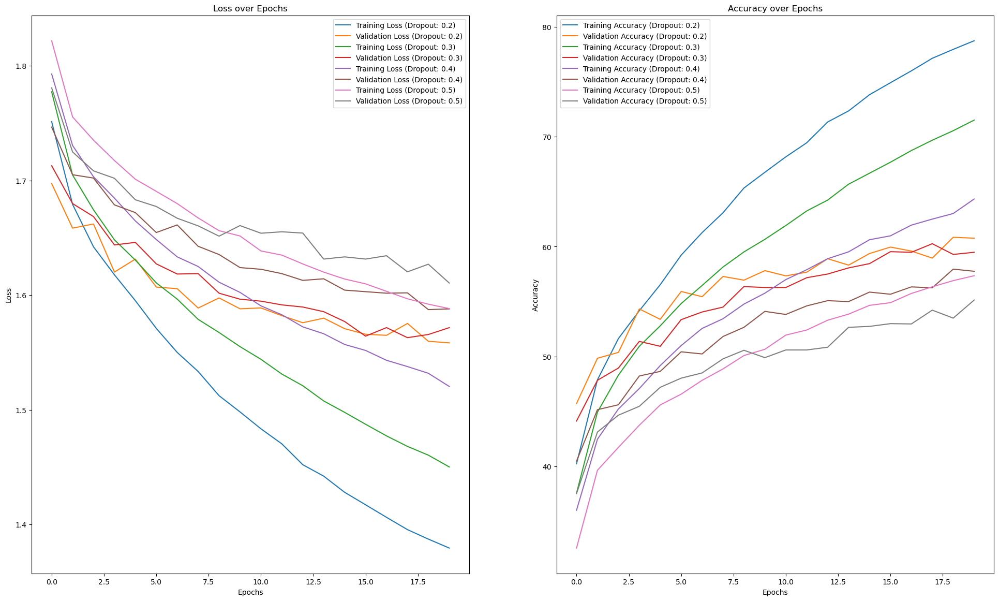

In [82]:
# Define the fixed kernel size and dense layer configurations
kernel_size = [(3, 3), (3, 3), (3, 3), (3, 3)]

dropout_rates = [0.2, 0.3, 0.4, 0.5]

# Initialize the plots
plt.figure(figsize=(24, 14))

# Create subplots for loss and accuracy
ax1 = plt.subplot(1, 2, 1)
ax2 = plt.subplot(1, 2, 2)

# Iterate over each dense configuration

for dropout in dropout_rates:
    # Construct the filename
    filename = f'kernels={kernel_size} dropout_rate={dropout}_history.npy'
        
    # Load the training history
    history = np.load(filename, allow_pickle=True).item()

    # Extract loss and accuracy
    loss = history['loss']
    val_loss = history['val_loss']
    accuracy = history['accuracy']
    val_accuracy = history['val_accuracy']

    # Plot the loss over epochs
    ax1.plot(loss, label=f'Training Loss (Dropout: {dropout})')
    ax1.plot(val_loss, label=f'Validation Loss (Dropout: {dropout})')

    # Plot the accuracy over epochs
    ax2.plot(accuracy, label=f'Training Accuracy (Dropout: {dropout})')
    ax2.plot(val_accuracy, label=f'Validation Accuracy (Dropout: {dropout})')

# Set titles and labels for the loss subplot
ax1.set_title('Loss over Epochs')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.legend()

# Set titles and labels for the accuracy subplot
ax2.set_title('Accuracy over Epochs')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.legend()

# Show the plots
plt.show()


# 4. Data Augmentation Hyperparameter Optimization

In [238]:
class TransformDataset(Dataset):
    def __init__(self, x, y, transform=None):
        self.x = x
        self.y = y
        self.transform = transform

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        image = self.x[idx].numpy()  # Convert tensor to NumPy array
        if image.shape[0] == 1:  # Grayscale image with shape (1, H, W)
            image = image.squeeze(0)  # Remove the channel dimension
        image = Image.fromarray(np.uint8(image * 255))  # Convert to PIL Image
        label = self.y[idx]
        if self.transform:
            image = self.transform(image)
        return image, label  
train_transform = transforms.Compose([
transforms.RandomHorizontalFlip(),
transforms.RandomRotation(degrees=0),
transforms.ToTensor()
])
def run_test_aug(model, optimizer, criterion, scheduler, epochs, batch_size, x_train, y_train, x_val, y_val, x_test, y_test, model_name=''):
    train_data = TransformDataset(x_train, y_train, transform=train_transform)
    val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
    test_data = TensorDataset(torch.tensor(x_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32))

    train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_data, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=False)

    history = {'loss': [], 'val_loss': [], 'accuracy': [], 'val_accuracy': []}
    start_time = time.time()

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            labels = torch.argmax(labels, dim=1)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_loader)
        epoch_acc = 100 * correct / total
        history['loss'].append(epoch_loss)
        history['accuracy'].append(epoch_acc)

        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0
        with torch.no_grad():
            for val_inputs, val_labels in val_loader:
                val_outputs = model(val_inputs)
                val_labels = torch.argmax(val_labels, dim=1)
                val_loss += criterion(val_outputs, val_labels).item()
                _, val_predicted = torch.max(val_outputs.data, 1)
                val_total += val_labels.size(0)
                val_correct += (val_predicted == val_labels).sum().item()

        val_loss /= len(val_loader)
        val_acc = 100 * val_correct / val_total
        history['val_loss'].append(val_loss)
        history['val_accuracy'].append(val_acc)

        if scheduler:
            scheduler.step()

        print(f"Epoch {epoch+1}/{epochs}, Loss: {epoch_loss:.4f}, Accuracy: {epoch_acc:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_acc:.2f}%")

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    model.eval()
    with torch.no_grad():
        for test_inputs, test_labels in test_loader:
            test_outputs = model(test_inputs)
            test_labels = torch.argmax(test_labels, dim=1)
            test_loss += criterion(test_outputs, test_labels).item()
            _, test_predicted = torch.max(test_outputs.data, 1)
            test_total += test_labels.size(0)
            test_correct += (test_predicted == test_labels).sum().item()

    test_loss /= len(test_loader)
    test_acc = 100 * test_correct / test_total

    print("Evaluate on test data")
    print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_acc:.2f}%")
    print("--- %s seconds ---" % (time.time() - start_time))

    # Plotting loss and accuracy
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history['loss'], label='Training Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history['accuracy'], label='Training Accuracy')
    plt.plot(history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy (%)')
    plt.title('Training and Validation Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

    #torch.save(model.state_dict(), model_name + '.pth')
    np.save(model_name + '_history.npy', history)
    return history


# Horizontal Flip

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

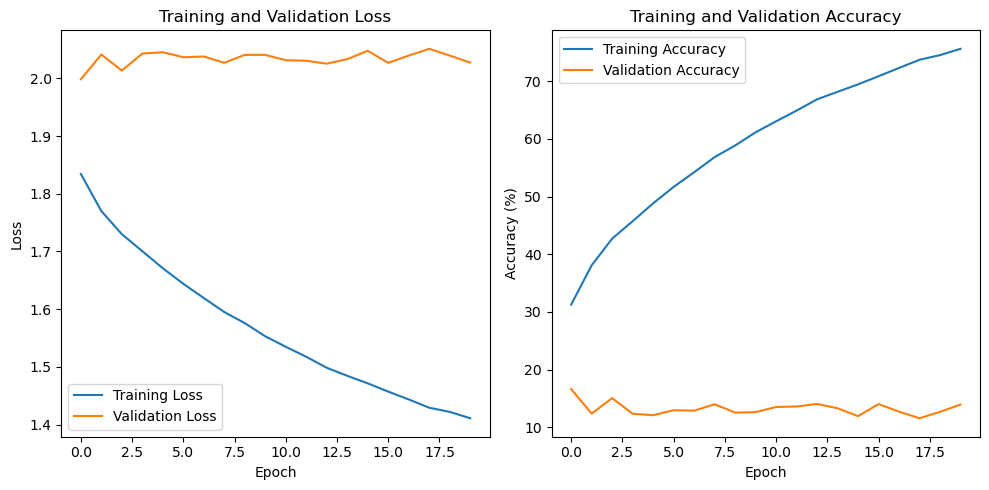

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

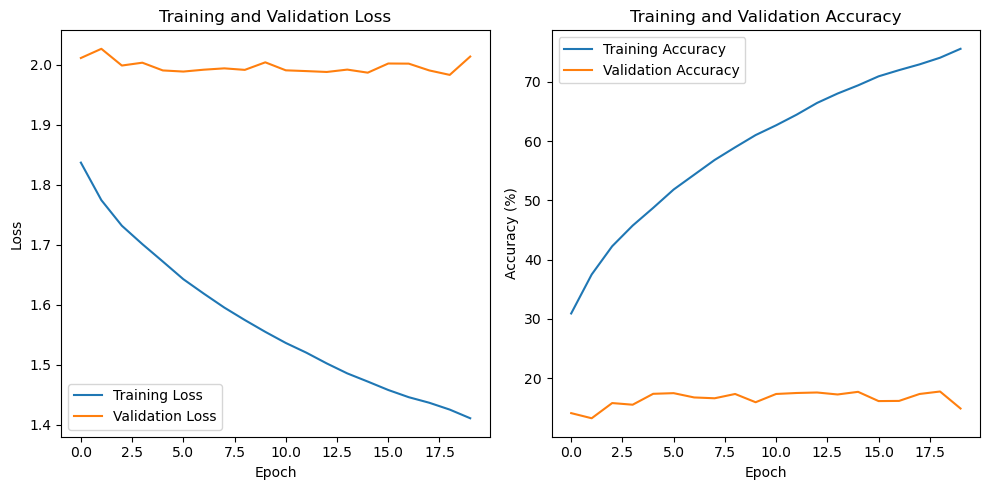

In [239]:
# Hyperparameters
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4

Horizontal_Flip = [True, False]
histories = []

# Define a fixed rotation range value
rotation_range = 0

for hf in Horizontal_Flip:
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(p=hf),
        transforms.RandomRotation(degrees=rotation_range),
        transforms.ToTensor(),
    ])
    kernelsizes = [(3, 3) for _ in range(layers)]
    pooling = [(2, 2) for _ in range(3)]
    filterunits = [initial * (2 ** i) for i in range(len(kernelsizes))]
    dense = [filterunits[-1], filterunits[- 2]]

    model_name = f'kernels={kernelsizes} rotation_range={rotation_range}'

    model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.2) 

    model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay)
    print(model)
    histories.append(run_test_aug(model, optimizer, criterion, scheduler, epochs, batchsize, x_train, y_train, x_val, y_val, x_test, y_test, model_name))

# RandomRotation

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

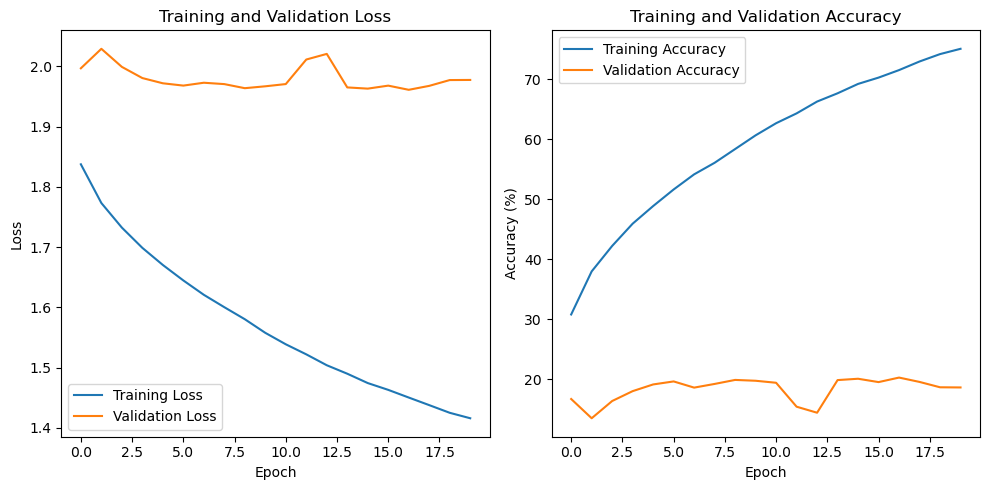

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

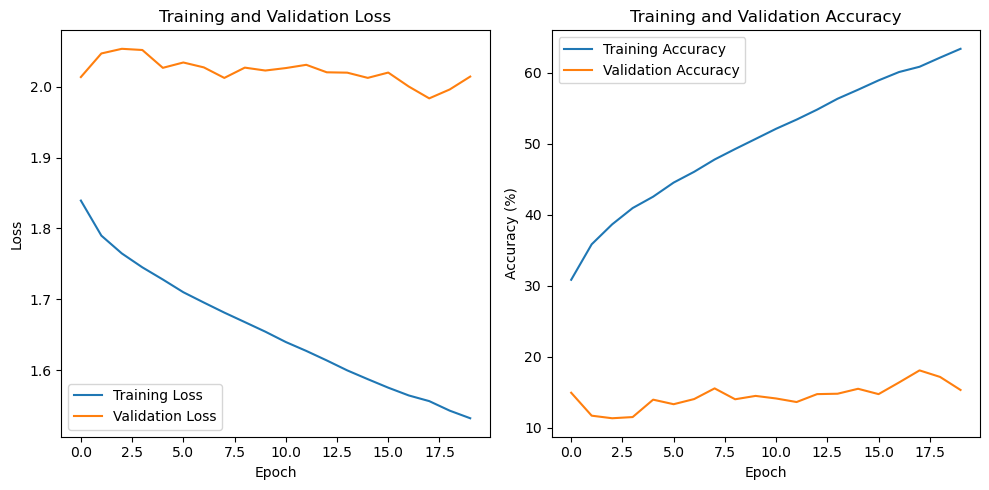

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

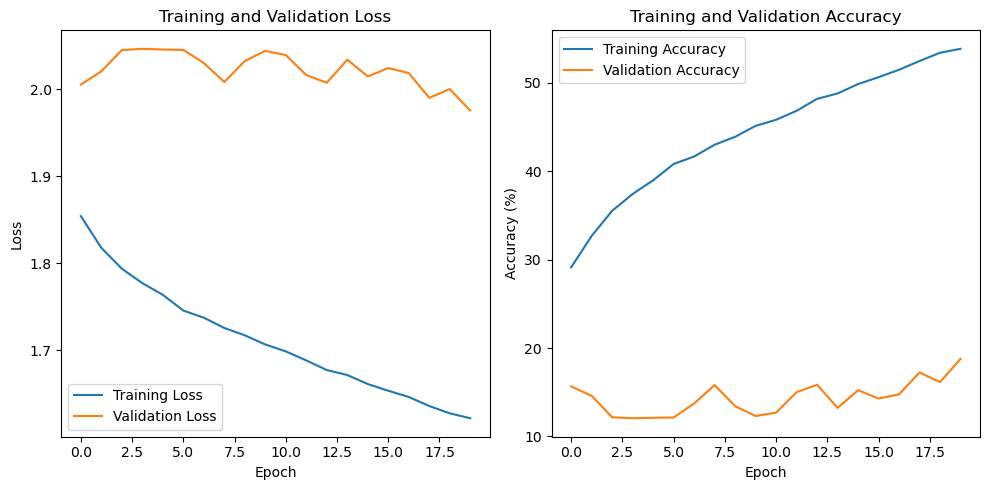

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

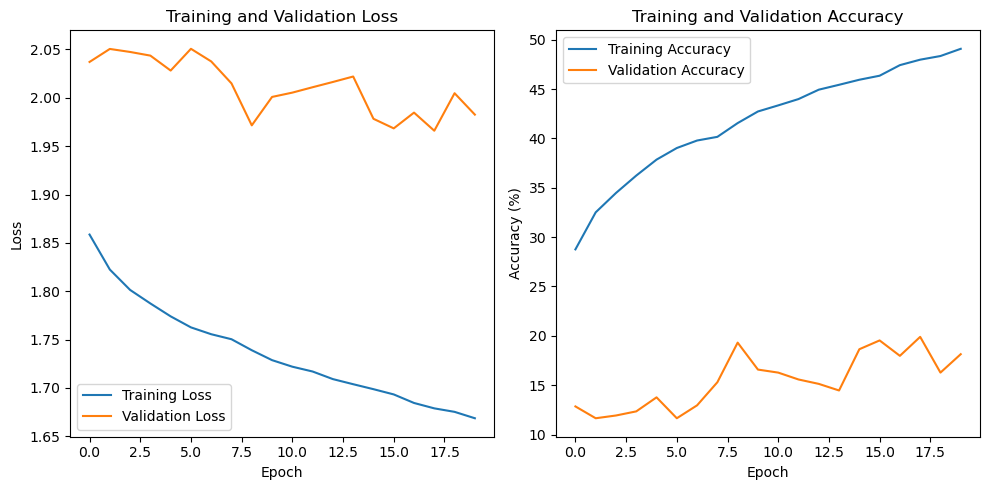

In [240]:
# Hyperparameters
learning_rate = 1e-4
lr_decay = 1
L2_reg_rate = 0
batchsize = 64
epochs = 20
initial = 64
layers = 4

Horizontal_Flip = False
histories = []

# Define different rotation range value
rotation_range = [0,10,20,30]

for rr in rotation_range:
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(p=Horizontal_Flip),
        transforms.RandomRotation(degrees=rr),
        transforms.ToTensor(),
    ])
    kernelsizes = [(3, 3) for _ in range(layers)]
    pooling = [(2, 2) for _ in range(3)]
    filterunits = [initial * (2 ** i) for i in range(len(kernelsizes))]
    dense = [filterunits[-1], filterunits[- 2]]

    model_name = f'kernels={kernelsizes} rotation_range={rotation_range}'

    model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.2)  

    model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay)
    print(model)
    histories.append(run_test_aug(model, optimizer, criterion, scheduler, epochs, batchsize, x_train, y_train, x_val, y_val, x_test, y_test, model_name))

# 5. Final Best Model

Best model with (50) epochs on validation & test data

In [189]:
# Define the same CNN model
class CNNModel(nn.Module):
    def __init__(self, activation_function='relu', padding='same', kernel_sizes=[(3,3)], filters=(8, 12), 
                 pooling_kernels = [(2,2)], dilation_rate = (1,1), strides = (1,1), 
                 input_shape=(1, 48, 48), dense_units=[], output_classes=7, dropout_rate=0):
        super(CNNModel, self).__init__()

        self.activation_function = activation_function
        self.conv_layers = nn.ModuleList()
        self.pooling_layers = nn.ModuleList()
        self.batchnorm_layers = nn.ModuleList()
        self.dropout_rate = dropout_rate

        in_channels = input_shape[0]
        for i in range(len(filters)):
            self.conv_layers.append(nn.Conv2d(
                in_channels=in_channels,
                out_channels=filters[i],
                kernel_size=kernel_sizes[i],
                padding='same' if padding == 'same' else 0,
                stride=strides,
                dilation=dilation_rate if i == 0 else (1, 1)
            ))
            in_channels = filters[i]
            
            if i < len(pooling_kernels):
                self.pooling_layers.append(nn.MaxPool2d(kernel_size=pooling_kernels[i]))

            if dropout_rate != 0:
                self.batchnorm_layers.append(nn.BatchNorm2d(filters[i]))
        
        self.flatten = nn.Flatten()

        # Calculate the size of the output from the last convolutional layer
        self.conv_output_size = self._get_conv_output_size(input_shape)
        
        self.fc_layers = nn.ModuleList()
        in_features = self.conv_output_size
        for units in dense_units:
            self.fc_layers.append(nn.Linear(in_features, units))
            in_features = units
        
        self.output_layer = nn.Linear(in_features, output_classes)

    def _get_conv_output_size(self, input_shape):
        with torch.no_grad():
            input_tensor = torch.zeros(1, *input_shape)
            output = input_tensor
            for i in range(len(self.conv_layers)):
                output = self.conv_layers[i](output)
                if i < len(self.pooling_layers):
                    output = self.pooling_layers[i](output)
                if self.dropout_rate != 0:
                    output = self.batchnorm_layers[i](output)
            output_size = output.numel()
        return output_size

    def forward(self, x):
        for i in range(len(self.conv_layers)):
            x = self.conv_layers[i](x)
            if self.activation_function == 'relu':
                x = F.relu(x)
            elif self.activation_function == 'sigmoid':
                x = torch.sigmoid(x)
            elif self.activation_function == 'tanh':
                x = torch.tanh(x)
            
            if i < len(self.pooling_layers):
                x = self.pooling_layers[i](x)

            if self.dropout_rate != 0:
                x = self.batchnorm_layers[i](x)
                x = F.dropout(x, p=self.dropout_rate, training=self.training)
        
        x = self.flatten(x)
        for layer in self.fc_layers:
            x = layer(x)
            if self.activation_function == 'relu':
                x = F.relu(x)
            elif self.activation_function == 'sigmoid':
                x = torch.sigmoid(x)
            elif self.activation_function == 'tanh':
                x = torch.tanh(x)
            if self.dropout_rate != 0:
                x = F.dropout(x, p=self.dropout_rate, training=self.training)

        x = self.output_layer(x)
        return F.softmax(x, dim=1)

# Extract Images
def extract_images(datapoints):
    width, height = 48, 48
    X = []
    for sequence in datapoints:
        pixels = [int(p) for p in sequence.split(' ')]
        pixels = np.asarray(pixels).reshape(width, height)
        X.append(pixels.astype('float32'))
    X = np.asarray(X)
    X = np.expand_dims(X, 1)  # Change here to match PyTorch's expected input shape (N, C, H, W)
    return X

# Load and preprocess FER13 data
def load_FER13():
    data = pd.read_csv('fer2013.csv')
    X = data['pixels']
    Y = data['emotion']
    
    x_train = X[data['Usage'] == 'Training'].values
    x_val = X[data['Usage'] == 'PrivateTest'].values
    x_test = X[data['Usage'] == 'PublicTest'].values

    y_train = Y[data['Usage'] == 'Training'].values
    y_val = Y[data['Usage'] == 'PrivateTest'].values
    y_test = Y[data['Usage'] == 'PublicTest'].values

    onehot_encoder = OneHotEncoder(sparse=False)
    y_train = onehot_encoder.fit_transform(y_train.reshape(-1, 1))
    y_val = onehot_encoder.transform(y_val.reshape(-1, 1))
    y_test = onehot_encoder.transform(y_test.reshape(-1, 1))

    x_train = extract_images(x_train)
    x_val = extract_images(x_val)
    x_test = extract_images(x_test)

    train_mean = np.mean(x_train, axis=0)
    train_std = np.std(x_train, axis=0)

    x_train = (x_train - train_mean) / train_std
    x_val = (x_val - train_mean) / train_std
    x_test = (x_test - train_mean) / train_std

    x_train = torch.tensor(x_train, dtype=torch.float32)
    x_val = torch.tensor(x_val, dtype=torch.float32)
    x_test = torch.tensor(x_test, dtype=torch.float32)
    y_train = torch.tensor(y_train, dtype=torch.long)
    y_val = torch.tensor(y_val, dtype=torch.long)
    y_test = torch.tensor(y_test, dtype=torch.long)

    return (x_train, y_train), (x_val, y_val), (x_test, y_test)

# Compile model
def compile_model(model, initial_lr, lr_decay, L2_reg_rate):
    optimizer = optim.Adam(model.parameters(), lr=initial_lr, weight_decay=L2_reg_rate)
    if lr_decay != 1:
        scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=lr_decay)
    else:
        scheduler = None
    criterion = nn.CrossEntropyLoss()
    return model, optimizer, criterion, scheduler

# Evaluate the model
def evaluate_model(model, dataloader):
    model.eval()
    y_true = []
    y_pred = []
    with torch.no_grad():
        for inputs, labels in dataloader:
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            y_true.extend(labels.argmax(dim=1).cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())
    return y_true, y_pred

def calculate_metrics(y_true, y_pred):
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, average='weighted')
    recall = recall_score(y_true, y_pred, average='weighted')
    f1 = f1_score(y_true, y_pred, average='weighted')
    report = classification_report(y_true, y_pred)
    return accuracy, precision, recall, f1, report

In [190]:
# Training loop
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=25):
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        model.train()  # Set model to training mode
        running_loss = 0.0
        running_corrects = 0

        for inputs, labels in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels.argmax(dim=1))
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, preds = torch.max(outputs, 1)
            running_corrects += torch.sum(preds == labels.argmax(dim=1)).item()

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = running_corrects / len(train_loader.dataset)

        print(f'Train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

        model.eval()  # Set model to evaluate mode
        val_loss = 0.0
        val_corrects = 0

        for inputs, labels in val_loader:
            outputs = model(inputs)
            loss = criterion(outputs, labels.argmax(dim=1))
            val_loss += loss.item() * inputs.size(0)
            _, preds = torch.max(outputs, 1)
            val_corrects += torch.sum(preds == labels.argmax(dim=1)).item()

        val_loss = val_loss / len(val_loader.dataset)
        val_acc = val_corrects / len(val_loader.dataset)

        print(f'Val Loss: {val_loss:.4f} Acc: {val_acc:.4f}')

        if val_acc > best_acc:
            best_acc = val_acc
            best_model_wts = copy.deepcopy(model.state_dict())

        if scheduler:
            scheduler.step()

    model.load_state_dict(best_model_wts)
    torch.save(model.state_dict(), './models/best_model.pth')
    return model

# Plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, classes):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

In [191]:
# Load Data
(x_train, y_train), (x_val, y_val), (x_test, y_test) = load_FER13()
train_data = TensorDataset(torch.tensor(x_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
test_data = TensorDataset(torch.tensor(x_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32))

train_loader = DataLoader(train_data, batch_size=64, shuffle=True)
val_loader = DataLoader(val_data, batch_size=64, shuffle=False)
test_loader = DataLoader(test_data, batch_size=64, shuffle=False)


# Initialize the CNN model
initial = 64
layers = 4
kernelsizes = [(3, 3) for _ in range(layers)]
pooling = [(2, 2) for _ in range(3)]
filterunits = [initial * 2**i for i in range(len(kernelsizes))]
dense = [filterunits[-1], filterunits[-2]]  


/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [192]:
# Suppress specific warnings
warnings.filterwarnings("ignore", message="To copy construct from a tensor*")

model = CNNModel(
    activation_function='relu',
    padding='same',
    kernel_sizes=kernelsizes,
    filters=filterunits,
    pooling_kernels=pooling,
    strides=(1, 1),
    input_shape=(1, 48, 48),
    dense_units=dense,
    output_classes=7,
    dropout_rate=0.20  
)

# Compile the model
learning_rate = 1e-4
lr_decay = 1  
L2_reg_rate = 0

model, optimizer, criterion, scheduler = compile_model(model, learning_rate, lr_decay, L2_reg_rate)

# Train the model
num_epochs = 50
model = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs)

# Evaluate on test data
y_true, y_pred = evaluate_model(model, test_loader)
accuracy, precision, recall, f1, report = calculate_metrics(y_true, y_pred)

print(f'Test Accuracy: {accuracy:.4f}')
print(f'Test Precision: {precision:.4f}')
print(f'Test Recall: {recall:.4f}')
print(f'Test F1-Score: {f1:.4f}')
print(f'Classification Report:\n{report}')

# Plot confusion matrix
classes = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']
#plot_confusion_matrix(y_true, y_pred, classes)

Epoch 0/49
----------
Train Loss: 1.7567 Acc: 0.3967
Val Loss: 1.7016 Acc: 0.4525
Epoch 1/49
----------
Train Loss: 1.6883 Acc: 0.4688
Val Loss: 1.6858 Acc: 0.4681
Epoch 2/49
----------
Train Loss: 1.6506 Acc: 0.5061
Val Loss: 1.6538 Acc: 0.5038
Epoch 3/49
----------
Train Loss: 1.6171 Acc: 0.5431
Val Loss: 1.6311 Acc: 0.5280
Epoch 4/49
----------
Train Loss: 1.5934 Acc: 0.5669
Val Loss: 1.6232 Acc: 0.5372
Epoch 5/49
----------
Train Loss: 1.5740 Acc: 0.5889
Val Loss: 1.6127 Acc: 0.5442
Epoch 6/49
----------
Train Loss: 1.5534 Acc: 0.6101
Val Loss: 1.6068 Acc: 0.5534
Epoch 7/49
----------
Train Loss: 1.5334 Acc: 0.6308
Val Loss: 1.5987 Acc: 0.5567
Epoch 8/49
----------
Train Loss: 1.5173 Acc: 0.6462
Val Loss: 1.5944 Acc: 0.5637
Epoch 9/49
----------
Train Loss: 1.4979 Acc: 0.6667
Val Loss: 1.5844 Acc: 0.5737
Epoch 10/49
----------
Train Loss: 1.4821 Acc: 0.6837
Val Loss: 1.5781 Acc: 0.5815
Epoch 11/49
----------
Train Loss: 1.4691 Acc: 0.6960
Val Loss: 1.5892 Acc: 0.5665
Epoch 12/49
--

/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/a

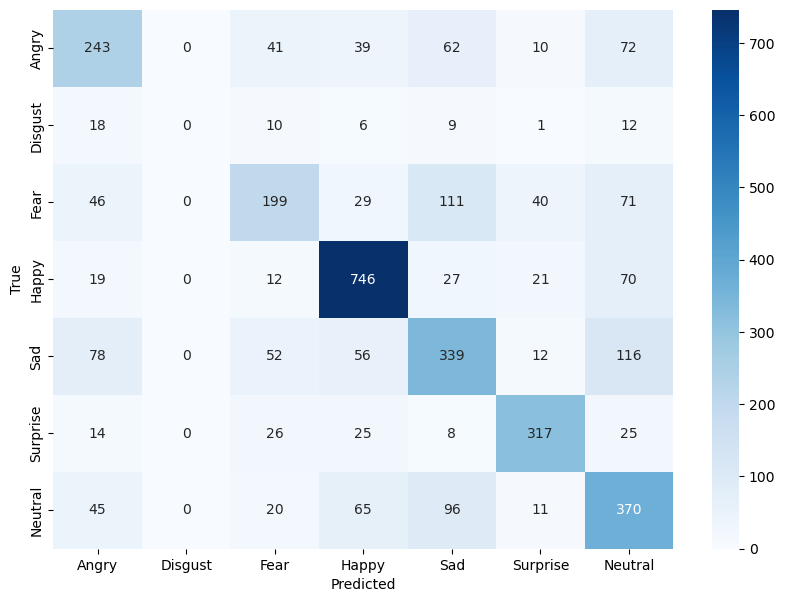

In [193]:
#Confusion Matrix
plot_confusion_matrix(y_true, y_pred, classes)

Plot correctly and incorrectly classified images

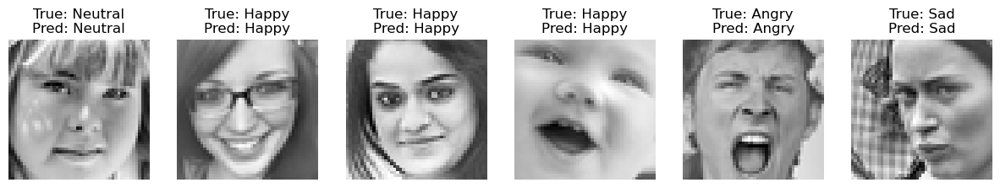

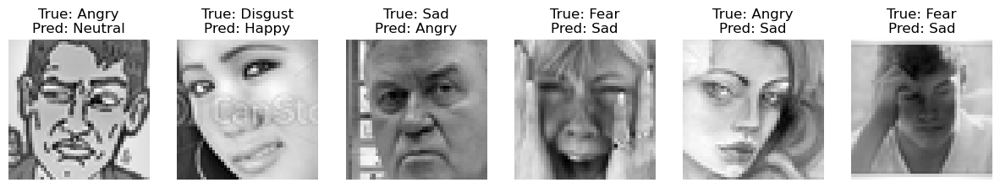

In [194]:
def plot_classified_images(images, true_labels, pred_labels, classes, correct=True, num_images=10):
    classified_indices = [i for i in range(len(true_labels)) if (true_labels[i] == pred_labels[i]) == correct]
    if len(classified_indices) < num_images:
        num_images = len(classified_indices)
    
    plt.figure(figsize=(15, 5))
    for i, index in enumerate(classified_indices[:num_images]):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(images[index][0], cmap='gray')
        plt.title(f'True: {classes[true_labels[index]]}\nPred: {classes[pred_labels[index]]}')
        plt.axis('off')
    plt.show()

# Convert y_true from one-hot encoding to class indices
y_true_indices = [np.argmax(label) for label in y_test.numpy()]

# Plot 5 correctly classified images
plot_classified_images(x_test.numpy(), y_true_indices, y_pred, classes, correct=True, num_images=6)

# Plot 5 incorrectly classified images
plot_classified_images(x_test.numpy(), y_true_indices, y_pred, classes, correct=False, num_images=6)


# With k-fold cross validation

In [135]:
# Load and preprocess FER13 data
def load_FER13_kfold():
    data = pd.read_csv('fer2013.csv')
    X = data['pixels']
    Y = data['emotion']
    
    x_data = X.values
    y_data = Y.values

    onehot_encoder = OneHotEncoder(sparse=False)
    y_data = onehot_encoder.fit_transform(y_data.reshape(-1, 1))

    x_data = extract_images(x_data)

    train_mean = np.mean(x_data, axis=0)
    train_std = np.std(x_data, axis=0)

    x_data = (x_data - train_mean) / train_std

    x_data = torch.tensor(x_data, dtype=torch.float32)
    y_data = torch.tensor(y_data, dtype=torch.long)

    return x_data, y_data


In [207]:
# Suppress specific warnings
warnings.filterwarnings("ignore", message="To copy construct from a tensor*")

# Define the evaluate function
def evaluate(model, dataloader, criterion):
    model.eval()
    total_loss = 0.0
    total_corrects = 0
    total_samples = 0
    y_true = []
    y_pred = []

    with torch.no_grad():
        for inputs, labels in dataloader:
            outputs = model(inputs)
            loss = criterion(outputs, labels.argmax(dim=1))
            _, preds = torch.max(outputs, 1)
            total_loss += loss.item() * inputs.size(0)
            total_corrects += torch.sum(preds == labels.argmax(dim=1)).item()
            total_samples += inputs.size(0)
            y_true.extend(labels.argmax(dim=1).cpu().numpy())
            y_pred.extend(preds.cpu().numpy())

    avg_loss = total_loss / total_samples
    accuracy = total_corrects / total_samples
    precision = precision_score(y_true, y_pred, average='weighted')
    recall = recall_score(y_true, y_pred, average='weighted')
    f1 = f1_score(y_true, y_pred, average='weighted')
    report = classification_report(y_true, y_pred)

    return avg_loss, accuracy, precision, recall, f1, report

# Define k-fold cross-validation function
def k_fold_cross_validation(model, criterion, optimizer, scheduler, train_loader, val_loader, test_loader, num_epochs=25, num_folds=5):
    fold_metrics = []
    fold_reports = []

    for fold, (train_idx, val_idx) in enumerate(KFold(n_splits=num_folds, shuffle=True, random_state=42).split(train_loader.dataset)):
        print(f'Fold {fold+1}/{num_folds}')
        
        # Subset the data for this fold
        train_subset = torch.utils.data.Subset(train_loader.dataset, train_idx)
        val_subset = torch.utils.data.Subset(train_loader.dataset, val_idx)
        
        train_loader_fold = torch.utils.data.DataLoader(train_subset, batch_size=train_loader.batch_size, shuffle=True)
        val_loader_fold = torch.utils.data.DataLoader(val_subset, batch_size=val_loader.batch_size, shuffle=False)
        
        # Train the model
        model = train_model(model, train_loader_fold, val_loader_fold, criterion, optimizer, scheduler, num_epochs=num_epochs)
        
        # Evaluate on the validation set
        val_loss, val_acc, val_precision, val_recall, val_f1, val_report = evaluate(model, val_loader_fold, criterion)
        
        # Save fold metrics
        fold_metrics.append({
            'fold': fold+1,
            'val_loss': val_loss,
            'val_accuracy': val_acc,
            'val_precision': val_precision,
            'val_recall': val_recall,
            'val_f1': val_f1
        })
        
        fold_reports.append(val_report)
    
    # Evaluate on the test set after k-fold cross-validation
    test_loss, test_acc, test_precision, test_recall, test_f1, test_report = evaluate(model, test_loader, criterion)
    
    return fold_metrics, fold_reports, test_loss, test_acc, test_precision, test_recall, test_f1, test_report


model = CNNModel(
    activation_function='relu', 
    padding='same', 
    kernel_sizes=[(3, 3) for _ in range(4)], 
    filters=[64 * 2**i for i in range(4)], 
    pooling_kernels=[(2, 2) for _ in range(3)], 
    input_shape=(1, 48, 48), 
    dense_units=[64 * 2**(4-1), 64 * 2**(4-2)], 
    output_classes=7, 
    dropout_rate=0.20
)

# Compile the model
model, optimizer, criterion, scheduler = compile_model(model, initial_lr=1e-4, lr_decay=1, L2_reg_rate=0)

# Perform k-fold cross-validation and evaluate on the test data
fold_metrics, fold_reports, test_loss, test_acc, test_precision, test_recall, test_f1, test_report = k_fold_cross_validation(model, criterion, optimizer, scheduler, train_loader, val_loader, test_loader, num_epochs=20, num_folds=3)

# Print test evaluation results
print(f'Test Loss: {test_loss:.4f}')
print(f'Test Accuracy: {test_acc:.4f}')
print(f'Test Precision: {test_precision:.4f}')
print(f'Test Recall: {test_recall:.4f}')
print(f'Test F1 Score: {test_f1:.4f}')
print('Test Classification Report:')
print(test_report)


Fold 1/3
Epoch 0/19
----------
Train Loss: 1.7743 Acc: 0.3772
Val Loss: 1.7289 Acc: 0.4232
Epoch 1/19
----------
Train Loss: 1.6999 Acc: 0.4570
Val Loss: 1.6963 Acc: 0.4577
Epoch 2/19
----------
Train Loss: 1.6635 Acc: 0.4941
Val Loss: 1.6748 Acc: 0.4793
Epoch 3/19
----------
Train Loss: 1.6320 Acc: 0.5266
Val Loss: 1.6503 Acc: 0.5079
Epoch 4/19
----------
Train Loss: 1.6069 Acc: 0.5556
Val Loss: 1.6409 Acc: 0.5173
Epoch 5/19
----------
Train Loss: 1.5846 Acc: 0.5788
Val Loss: 1.6356 Acc: 0.5213
Epoch 6/19
----------
Train Loss: 1.5594 Acc: 0.6044
Val Loss: 1.6250 Acc: 0.5327
Epoch 7/19
----------
Train Loss: 1.5437 Acc: 0.6200
Val Loss: 1.6229 Acc: 0.5353
Epoch 8/19
----------
Train Loss: 1.5223 Acc: 0.6421
Val Loss: 1.6154 Acc: 0.5457
Epoch 9/19
----------
Train Loss: 1.5067 Acc: 0.6591
Val Loss: 1.6119 Acc: 0.5490
Epoch 10/19
----------
Train Loss: 1.4885 Acc: 0.6778
Val Loss: 1.6130 Acc: 0.5447
Epoch 11/19
----------
Train Loss: 1.4725 Acc: 0.6937
Val Loss: 1.6028 Acc: 0.5556
Epoch

/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/a

Fold 2/3
Epoch 0/19
----------
Train Loss: 1.5012 Acc: 0.6610
Val Loss: 1.3659 Acc: 0.8013
Epoch 1/19
----------
Train Loss: 1.4787 Acc: 0.6845
Val Loss: 1.3913 Acc: 0.7760
Epoch 2/19
----------
Train Loss: 1.4610 Acc: 0.7044
Val Loss: 1.3862 Acc: 0.7809
Epoch 3/19
----------
Train Loss: 1.4489 Acc: 0.7151
Val Loss: 1.3867 Acc: 0.7801
Epoch 4/19
----------
Train Loss: 1.4265 Acc: 0.7384
Val Loss: 1.3915 Acc: 0.7750
Epoch 5/19
----------
Train Loss: 1.4102 Acc: 0.7562
Val Loss: 1.3946 Acc: 0.7715
Epoch 6/19
----------
Train Loss: 1.3955 Acc: 0.7707
Val Loss: 1.4004 Acc: 0.7657
Epoch 7/19
----------
Train Loss: 1.3836 Acc: 0.7834
Val Loss: 1.3975 Acc: 0.7696
Epoch 8/19
----------
Train Loss: 1.3740 Acc: 0.7928
Val Loss: 1.4091 Acc: 0.7563
Epoch 9/19
----------
Train Loss: 1.3641 Acc: 0.8034
Val Loss: 1.4154 Acc: 0.7492
Epoch 10/19
----------
Train Loss: 1.3557 Acc: 0.8106
Val Loss: 1.4080 Acc: 0.7563
Epoch 11/19
----------
Train Loss: 1.3498 Acc: 0.8176
Val Loss: 1.4157 Acc: 0.7503
Epoch

/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/a

Fold 3/3
Epoch 0/19
----------
Train Loss: 1.4946 Acc: 0.6692
Val Loss: 1.3716 Acc: 0.7951
Epoch 1/19
----------
Train Loss: 1.4748 Acc: 0.6897
Val Loss: 1.3789 Acc: 0.7872
Epoch 2/19
----------
Train Loss: 1.4536 Acc: 0.7111
Val Loss: 1.3809 Acc: 0.7849
Epoch 3/19
----------
Train Loss: 1.4282 Acc: 0.7390
Val Loss: 1.3727 Acc: 0.7931
Epoch 4/19
----------
Train Loss: 1.4162 Acc: 0.7504
Val Loss: 1.3778 Acc: 0.7888
Epoch 5/19
----------
Train Loss: 1.4030 Acc: 0.7628
Val Loss: 1.3808 Acc: 0.7857
Epoch 6/19
----------
Train Loss: 1.3916 Acc: 0.7751
Val Loss: 1.3962 Acc: 0.7700
Epoch 7/19
----------
Train Loss: 1.3821 Acc: 0.7846
Val Loss: 1.4015 Acc: 0.7655
Epoch 8/19
----------
Train Loss: 1.3695 Acc: 0.7970
Val Loss: 1.4106 Acc: 0.7545
Epoch 9/19
----------
Train Loss: 1.3616 Acc: 0.8064
Val Loss: 1.3944 Acc: 0.7721
Epoch 10/19
----------
Train Loss: 1.3532 Acc: 0.8138
Val Loss: 1.3988 Acc: 0.7678
Epoch 11/19
----------
Train Loss: 1.3480 Acc: 0.8197
Val Loss: 1.4033 Acc: 0.7628
Epoch

/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/a

Test Loss: 1.5898
Test Accuracy: 0.5698
Test Precision: 0.5650
Test Recall: 0.5698
Test F1 Score: 0.5645
Test Classification Report:
              precision    recall  f1-score   support

           0       0.44      0.49      0.46       467
           1       0.00      0.00      0.00        56
           2       0.44      0.36      0.40       496
           3       0.74      0.81      0.77       895
           4       0.45      0.54      0.49       653
           5       0.81      0.65      0.72       415
           6       0.52      0.49      0.50       607

    accuracy                           0.57      3589
   macro avg       0.49      0.48      0.48      3589
weighted avg       0.57      0.57      0.56      3589



/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/murad/a

#Visualize the learnt filters on different layers to check which is the internal representation
of your CNN model (e.g. you can check the model parameters for each convolutional layer
and transform the filters into an image). Display the relevant activations for different
emotions.

# 6. Visualize filters learned by the final model

In [219]:
# Load the cascade classifier for face detection
face_classifier = cv2.CascadeClassifier("./models/haarcascade_frontalface_default.xml")

# Load the trained model state
model_state = torch.load("./models/best_model_final.pth", map_location=torch.device('cpu'))
class_labels = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']

# Initialize the model
model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.20)
model.load_state_dict(model_state)
model.eval()  # Set the model to evaluation mode

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

In [223]:
# Load Data
(x_train, y_train), (x_val, y_val), (x_test, y_test) = load_FER13()
train_data = TensorDataset(torch.tensor(x_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32))
val_data = TensorDataset(torch.tensor(x_val, dtype=torch.float32), torch.tensor(y_val, dtype=torch.float32))
test_data = TensorDataset(torch.tensor(x_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32))

train_loader = DataLoader(train_data, batch_size=64, shuffle=True)
val_loader = DataLoader(val_data, batch_size=64, shuffle=False)
test_loader = DataLoader(test_data, batch_size=64, shuffle=False)


/Users/murad/anaconda/anaconda3/lib/python3.11/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


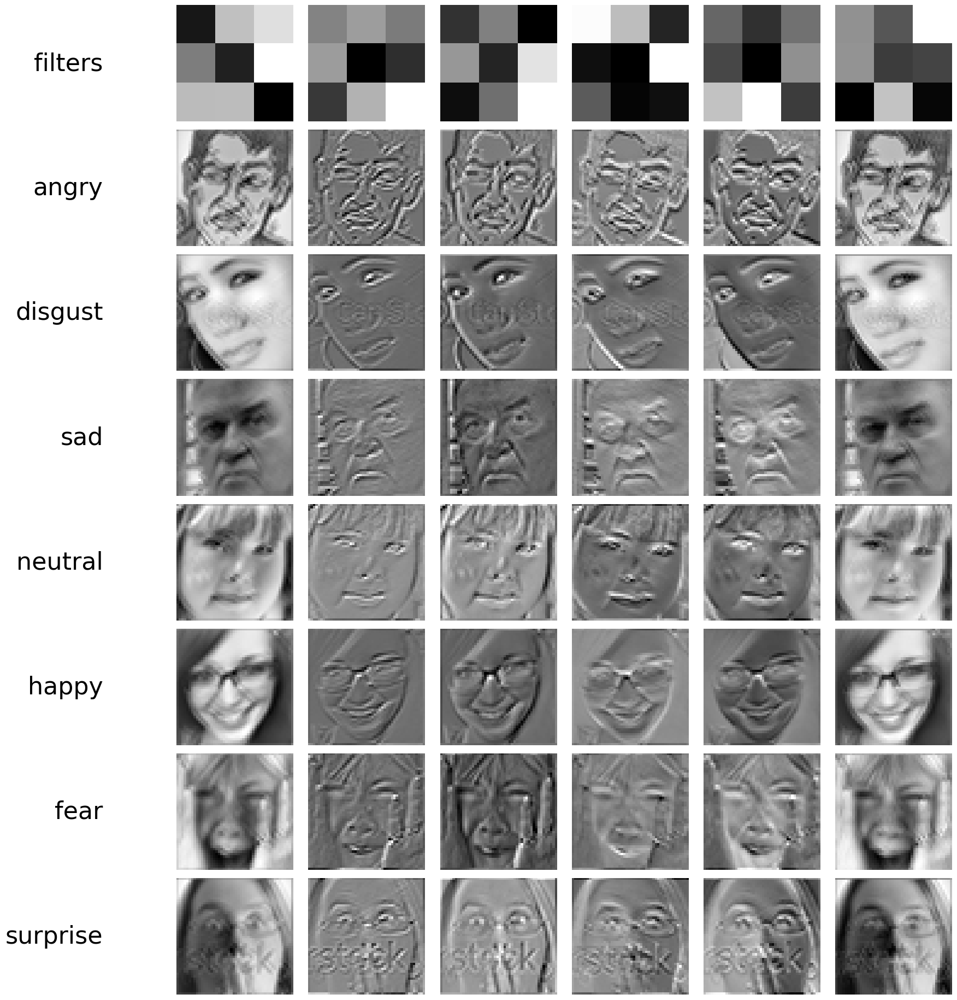

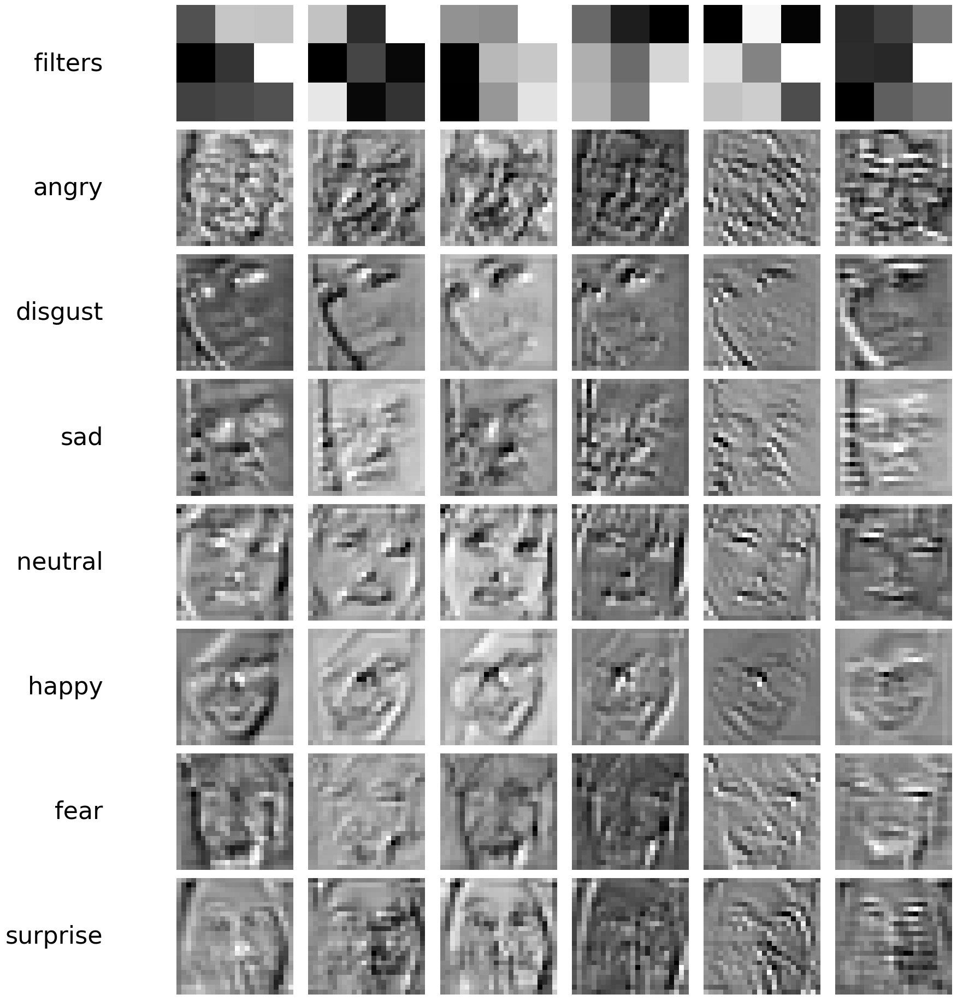

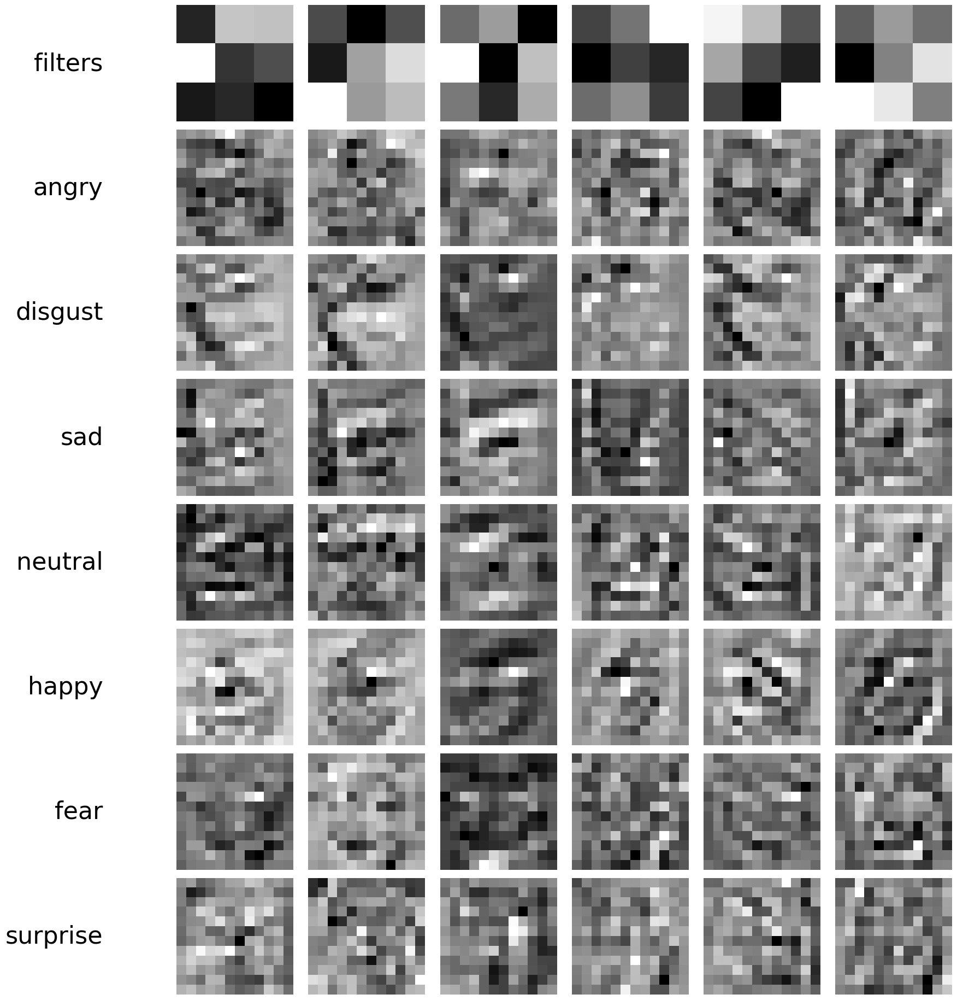

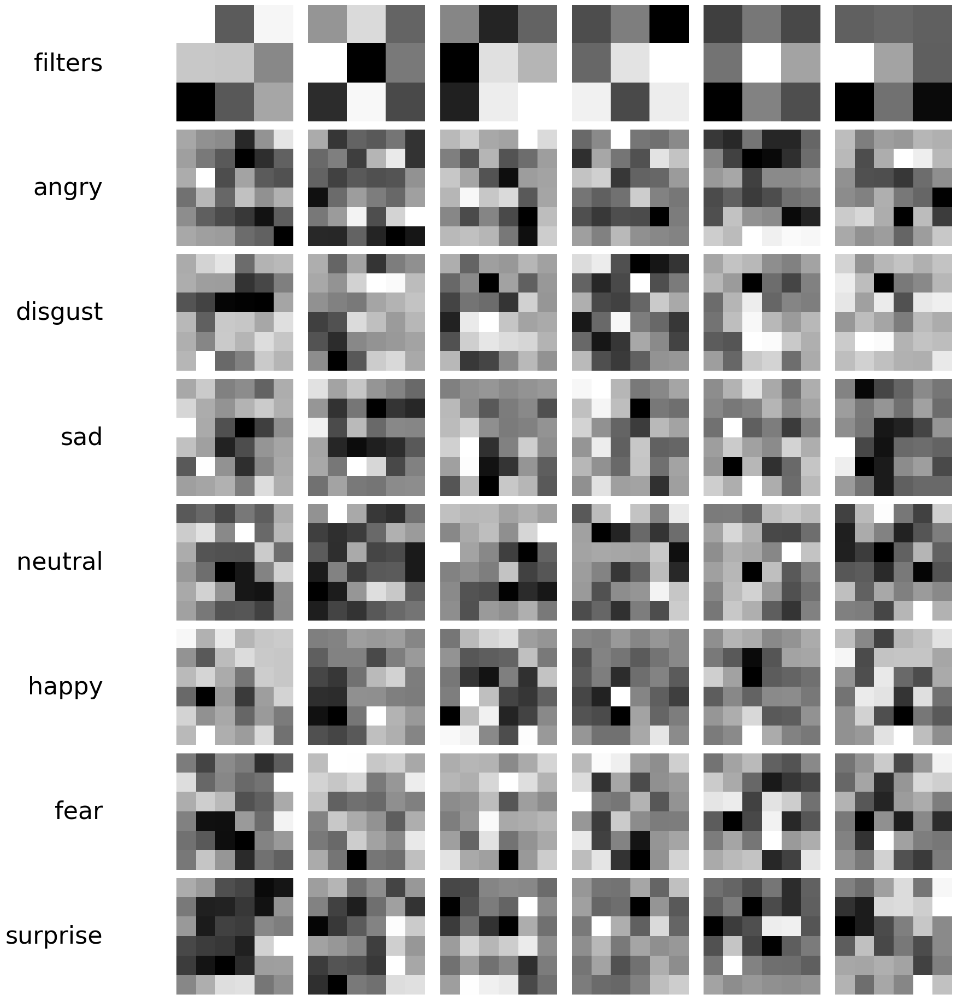

In [227]:
#function to visualize filters and activations
def visualize_layer_and_activations(model, layer, layer_name, dataloader, num_filters=6):
    model.eval()
    
    # Create a figure for the filters
    filters = layer.weight.data.cpu().numpy()
    fig, axes = plt.subplots(8, num_filters + 1, figsize=(20, 20))  # 1 row for filters, 7 rows for activations

    # Plot filters in the first row
    for i in range(num_filters):
        ax = axes[0, i + 1]
        if filters.shape[1] == 3:
            filter_img = filters[i].transpose(1, 2, 0)
            ax.imshow(filter_img)
        else:
            filter_img = filters[i, 0, :, :]
            ax.imshow(filter_img, cmap='gray')
        ax.axis('off')
    axes[0, 0].text(0.5, 0.5, 'filters', ha='right', va='center', rotation=0, fontsize=32)
    axes[0, 0].axis('off')  # Hide the empty subplot

    # Hook function to capture activations
    activations = {}
    def hook_fn(module, input, output):
        activations['output'] = output
    
    hook = layer.register_forward_hook(hook_fn)
    
    # Visualize activations for each emotion
    emotions_seen = set()
    row_index = 1  # Start plotting activations from the second row
    for images, labels in dataloader:
        images = images.to(device)
        labels = labels.to(device)
        for i in range(len(labels)):
            # Convert label to a scalar if it is one-hot encoded
            emotion_label = torch.argmax(labels[i]).item() if labels[i].dim() > 0 else labels[i].item()
            if emotion_label not in emotions_seen:
                with torch.no_grad():
                    model(images[i].unsqueeze(0))
                
                act = activations['output'].squeeze(0).cpu().numpy()
                num_activations = act.shape[0]
                
                for j in range(min(num_filters, num_activations)):
                    ax = axes[row_index, j + 1]
                    ax.imshow(act[j], cmap='gray')
                    ax.axis('off')
                axes[row_index, 0].text(0.5, 0.5, emotion_labels[emotion_label], ha='right', va='center', rotation=0, fontsize=32)
                axes[row_index, 0].axis('off')  # Hide the empty subplot
                
                emotions_seen.add(emotion_label)
                row_index += 1
                if len(emotions_seen) >= 7:  # We have 7 emotions
                    break
        if len(emotions_seen) >= 7:
            break

    hook.remove()
    
    # Save the figure
    plt.tight_layout(rect=[0.1, 0.03, 1, 0.95])
    plt.show()
    plt.close(fig)

# Ensure model and data are on the same device
model = model.to(device)

# Example usage: Visualize the filters and activations for all layers
for i, conv_layer in enumerate(model.conv_layers):
    layer_name = f'Conv Layer {i+1}'
    visualize_layer_and_activations(model, conv_layer, layer_name, test_loader, num_filters=6)


# 7. Webcam Testing

# 7.1 Transformer Model

In [169]:
# Use a pipeline as a high-level helper
from transformers import pipeline

pipe = pipeline("image-classification", model="dima806/facial_emotions_image_detection")

In [217]:
#live Webcam
processor = AutoImageProcessor.from_pretrained("dima806/facial_emotions_image_detection")
model1 = AutoModelForImageClassification.from_pretrained("dima806/facial_emotions_image_detection")
# Initialize webcam capture
cap = cv2.VideoCapture(1)

# Define face classifier
face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

class_labels1 = ['Sad', 'Disgust', 'Angry', 'Neutral', 'Fear', 'Surprise','Happy']  
while True:
    # Grab a single frame of video
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    frame = cv2.flip(frame, 1)
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, 1.3, 5)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_gray = gray[y:y + h, x:x + w]
        roi_gray = cv2.resize(roi_gray, (48, 48), interpolation=cv2.INTER_AREA)

        if np.sum([roi_gray]) != 0:
            roi = cv2.cvtColor(roi_gray, cv2.COLOR_GRAY2RGB)
            roi = processor(images=roi, return_tensors="pt")

            with torch.no_grad():
                outputs = model1(**roi)
                pred = torch.argmax(outputs.logits, dim=1).item()
                label = class_labels1[pred]

            label_position = (x, y)
            cv2.putText(frame, label, label_position, cv2.FONT_HERSHEY_COMPLEX, 2, (0, 255, 0), 3)
        else:
            cv2.putText(frame, "No Face Found", (20, 60), cv2.FONT_HERSHEY_COMPLEX, 2, (0, 255, 0), 3)

    cv2.imshow("Emotion Detector", frame)

    if cv2.waitKey(1) & 0xFF == ord("q"):
        break

cap.release()
cv2.destroyAllWindows()


In [216]:
# Initialize the image processor and model
processor = AutoImageProcessor.from_pretrained("dima806/facial_emotions_image_detection")
model1 = AutoModelForImageClassification.from_pretrained("dima806/facial_emotions_image_detection")

# Initialize webcam capture
cap = cv2.VideoCapture(1)

# Record video for 10 seconds
frames = []
start_time = time.time()
while time.time() - start_time < 10:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break
    frames.append(frame)

cap.release()

# Define face classifier
face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
class_labels1 = ['Sad', 'Disgust', 'Angry', 'Neutral', 'Fear', 'Surprise', 'Happy']

# Process each frame of the recorded video
processed_frames = []
for frame in frames:
    frame = cv2.flip(frame, 1)
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, 1.3, 5)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_gray = gray[y:y + h, x:x + w]
        roi_gray = cv2.resize(roi_gray, (48, 48), interpolation=cv2.INTER_AREA)

        if np.sum([roi_gray]) != 0:
            roi = cv2.cvtColor(roi_gray, cv2.COLOR_GRAY2RGB)
            roi = processor(images=roi, return_tensors="pt")

            with torch.no_grad():
                outputs = model1(**roi)
                pred = torch.argmax(outputs.logits, dim=1).item()
                label = class_labels1[pred]

            label_position = (x, y)
            cv2.putText(frame, label, label_position, cv2.FONT_HERSHEY_COMPLEX, 2, (0, 255, 0), 3)
        else:
            cv2.putText(frame, "No Face Found", (20, 60), cv2.FONT_HERSHEY_COMPLEX, 2, (0, 255, 0), 3)

    processed_frames.append(frame)

cv2.destroyAllWindows()

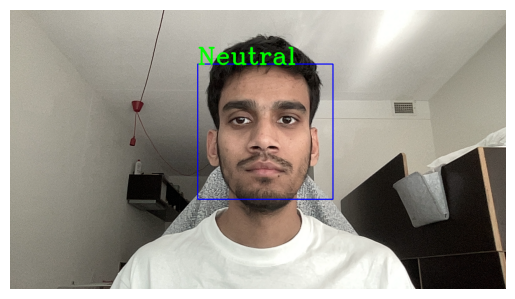

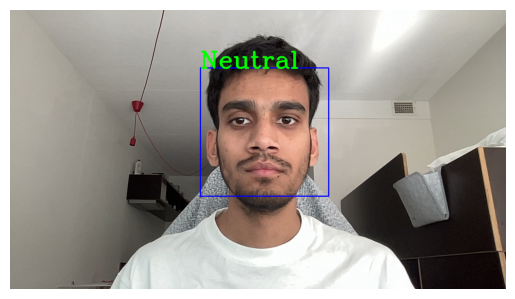

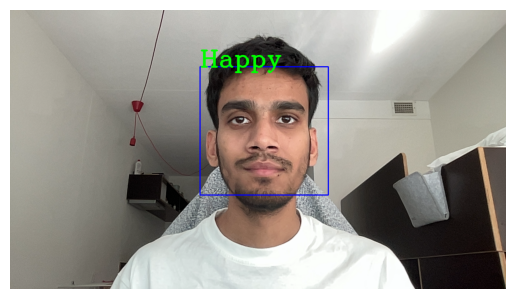

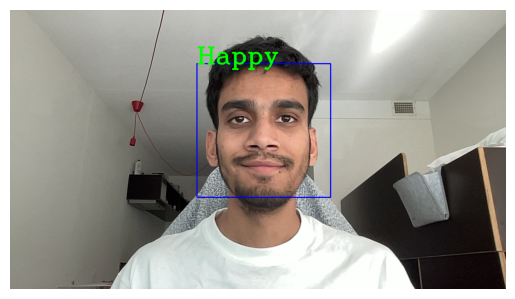

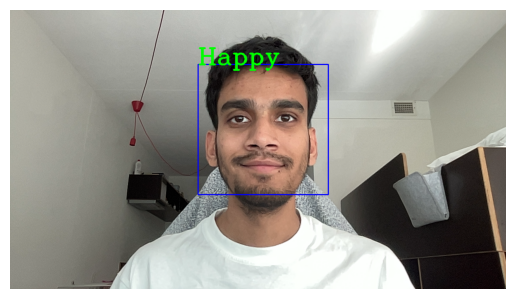

...

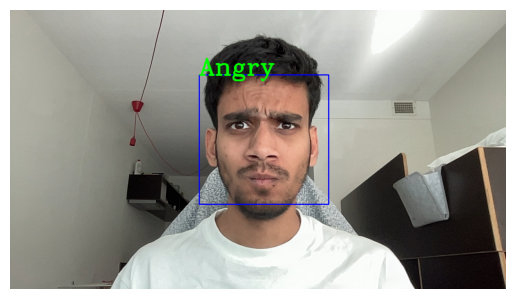

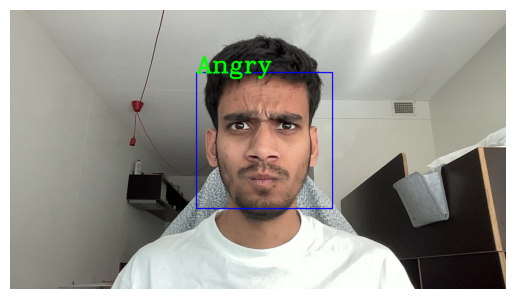

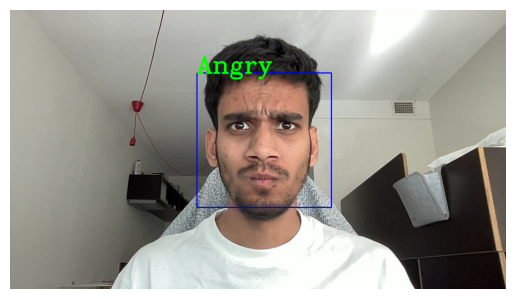

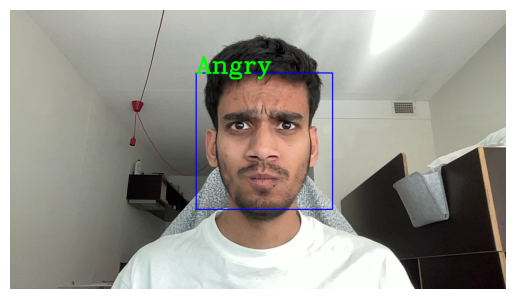

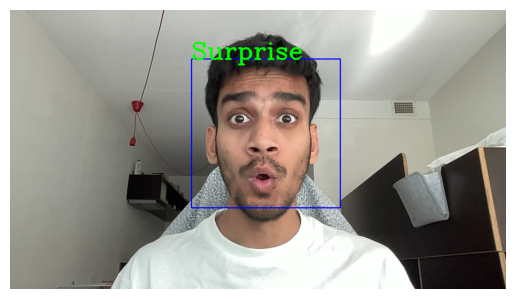

In [121]:
# Display the processed frames every 10 frames
for idx, frame in enumerate(processed_frames):
    if idx % 10 == 0:  # Display every 10th frame
        rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(rgb_frame)
        plt.axis('off')  # Hide axes
        plt.show()

# 7.2 Final Best Model 

In [218]:
# Load the cascade classifier for face detection
face_classifier = cv2.CascadeClassifier("./models/haarcascade_frontalface_default.xml")

# Load the trained model state
model_state = torch.load("./models/best_model_final.pth", map_location=torch.device('cpu'))
class_labels = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']

# Initialize the model
model = CNNModel(activation_function='relu', padding='same', kernel_sizes=kernelsizes,
                     filters=filterunits, pooling_kernels=pooling, dilation_rate=(1, 1),
                     strides=(1, 1), input_shape=(1, 48, 48), dense_units=dense, output_classes=7,
                     dropout_rate=0.20)
model.load_state_dict(model_state)
model.eval()  # Set the model to evaluation mode

CNNModel(
  (conv_layers): ModuleList(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (2): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (3): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=same)
  )
  (pooling_layers): ModuleList(
    (0-2): 3 x MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (batchnorm_layers): ModuleList(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc_layers): ModuleList(
    (0): Linear(in_features=18432, out_features=512, bi

In [214]:
# Initialize webcam capture
cap = cv2.VideoCapture(1)

while True:
    # Grab a single frame of video
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    frame = cv2.flip(frame, 1)
    labels = []
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, 1.3, 5)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_gray = gray[y : y + h, x : x + w]
        roi_gray = cv2.resize(roi_gray, (48, 48), interpolation=cv2.INTER_AREA)

        if np.sum([roi_gray]) != 0:
            roi = tt.functional.to_pil_image(roi_gray)
            roi = tt.functional.to_grayscale(roi)
            roi = tt.ToTensor()(roi).unsqueeze(0)

            # Make a prediction on the ROI
            with torch.no_grad():
                tensor = model(roi)
                pred = torch.max(tensor, dim=1)[1].tolist()
                label = class_labels[pred[0]]

            label_position = (x, y)
            cv2.putText(
                frame,
                label,
                label_position,
                cv2.FONT_HERSHEY_COMPLEX,
                2,
                (0, 255, 0),
                3,
            )
        else:
            cv2.putText(
                frame,
                "No Face Found",
                (20, 60),
                cv2.FONT_HERSHEY_COMPLEX,
                2,
                (0, 255, 0),
                3,
            )

    cv2.imshow("Emotion Detector", frame)

    if cv2.waitKey(1) & 0xFF == ord("q"):
        break

cap.release()
cv2.destroyAllWindows()

# Output Per frame

In [67]:
# Initialize webcam capture
cap = cv2.VideoCapture(1)

# Record video for 10 seconds
frames = []
start_time = time.time()
while time.time() - start_time < 10:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break
    frames.append(frame)

cap.release()

# Process each frame of the recorded video
processed_frames = []
for frame in frames:
    frame = cv2.flip(frame, 1)
    labels = []
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_classifier.detectMultiScale(gray, 1.3, 5)

    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_gray = gray[y : y + h, x : x + w]
        roi_gray = cv2.resize(roi_gray, (48, 48), interpolation=cv2.INTER_AREA)

        if np.sum([roi_gray]) != 0:
            roi = tt.functional.to_pil_image(roi_gray)
            roi = tt.functional.to_grayscale(roi)
            roi = tt.ToTensor()(roi).unsqueeze(0)

            # Make a prediction on the ROI
            with torch.no_grad():
                tensor = model(roi)
                pred = torch.max(tensor, dim=1)[1].tolist()
                label = class_labels[pred[0]]

            label_position = (x, y)
            cv2.putText(
                frame,
                label,
                label_position,
                cv2.FONT_HERSHEY_COMPLEX,
                2,
                (0, 255, 0),
                3,
            )
        else:
            cv2.putText(
                frame,
                "No Face Found",
                (20, 60),
                cv2.FONT_HERSHEY_COMPLEX,
                2,
                (0, 255, 0),
                3,
            )

    processed_frames.append(frame)


    if cv2.waitKey(1) & 0xFF == ord("q"):
        break

cv2.destroyAllWindows()


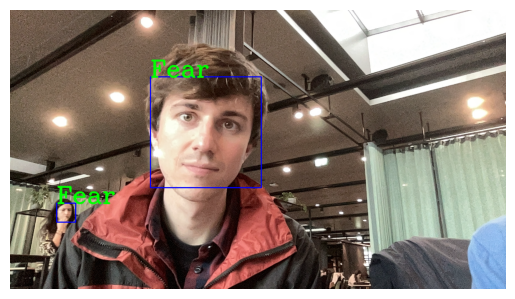

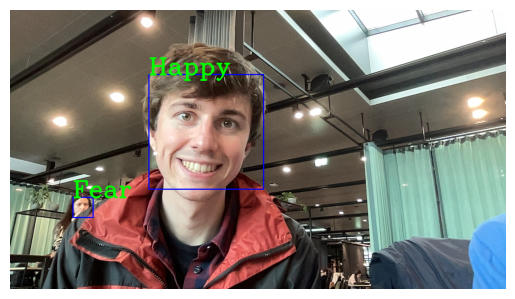

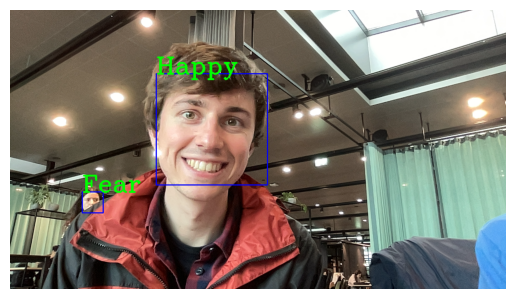

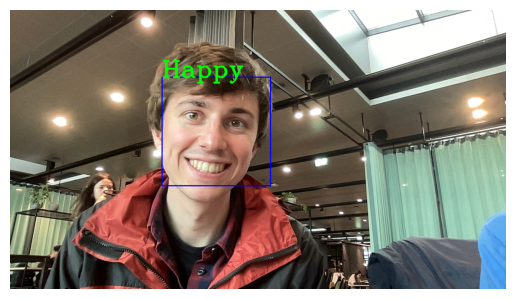

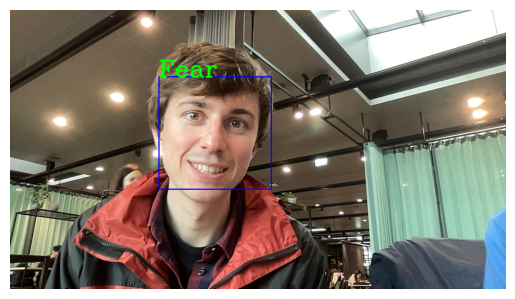

...

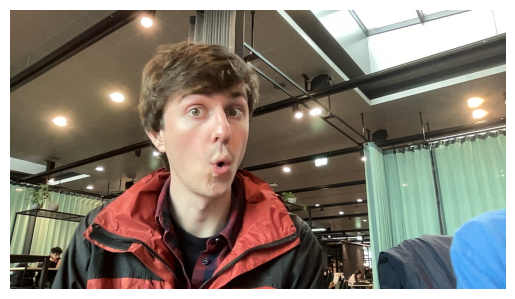

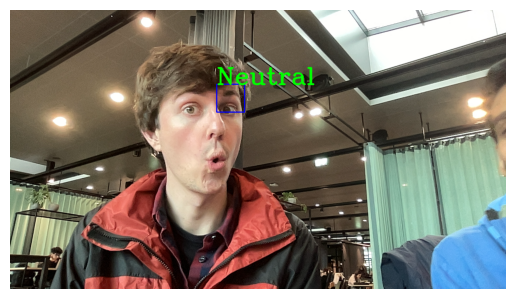

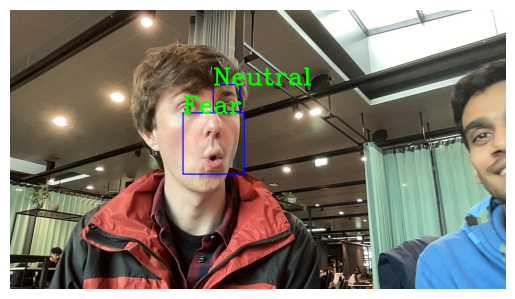

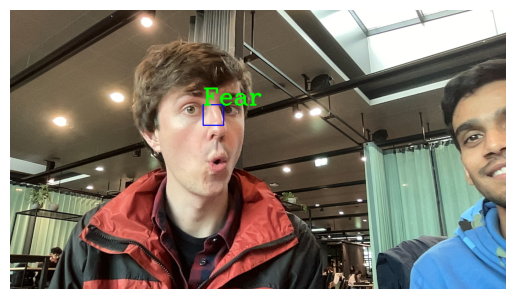

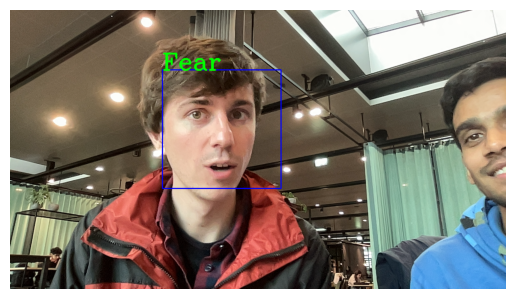

In [68]:
# Display the processed frames every 10 frames
for idx, frame in enumerate(processed_frames):
    if idx % 10 == 0:  # Display every 5th frame
        rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(rgb_frame)
        plt.axis('off')  # Hide axes
        plt.show()